In [7]:
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)
import keras.backend as K



## Some background reading

###### Space Weather:
- [Introduction](https://ccmc.gsfc.nasa.gov/RoR_WWW/SWREDI/2016/SpaceWeatherIntro_Bootcamp_2016.pdf)
- [Understanding space weather](https://www.sciencedirect.com/science/article/pii/S0273117715002252)

###### Particle Precipitation:
Here are a few particle precipitation resources that I believe are most valuable to start with:
- Technical details of the observations: [Redmon et al., [2017]](https://agupubs.onlinelibrary.wiley.com/doi/full/10.1002/2016JA023339)
- Creating particle precipitation models from these data: [Hardy et al., [1987]](https://doi.org/10.1029/JA090iA05p04229) and [Newell et al., [2009]](https://doi.org/10.1029/2009JA014326)
- Considered the 'state of the art' model: [OVATION PRIME](https://ccmc.gsfc.nasa.gov/models/modelinfo.php?model=Ovation%20Prime)



## Imports and utility functions


In [8]:
import numpy as np
import os
import pandas as pd
import seaborn as sns
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import datetime
from os.path import isfile, join
from sys import getsizeof
import glob

from random import *

from sklearn import *


from keras.models import Sequential, Model
from keras.layers import Dense, Conv1D, Flatten, Input, LSTM, TimeDistributed, MaxPooling1D
from keras.layers.merge import concatenate

import keras.backend as K



import sys
print(sys.maxsize)
np.set_printoptions(threshold=sys.maxsize*2)

9223372036854775807


## Prepare data for ML exploration (read in full DB created from standard_ML_DB_preparation.ipynb)


In [9]:
file_load_df_cumulative = 'ML_DB_subsamp_ext_full_dfCumulative_complexHemisphereCombine.csv'
DMSP_DATA_DIR=''
df_cumulative = pd.read_csv(os.path.join(DMSP_DATA_DIR,file_load_df_cumulative))
df_cumulative = df_cumulative.sort_values(by=['ID_SC', 'Datetimes'])
df_cumulative = df_cumulative.set_index('Datetimes')
df_cumulative.index = pd.to_datetime(df_cumulative.index)

cols_to_drop_validation = [c for c in df_cumulative.columns if ('STD' in c) | ('AVG' in c) | ('SC_AACGM_LTIME'==c)]
# cols_to_drop_validation = [c for c in df.columns if ('1min' in c) | ('3min' in c) | ('4min' in c) | ('5min' in c) | ('15min' in c) | ('newell' in c) | ('STD' in c) | ('AVG' in c) | ('SC_AACGM_LTIME'==c)]

df_cumulative = df_cumulative.drop(columns=cols_to_drop_validation)


In [19]:
def mean_errors_over_range(ytrue, ypred, nbins):
    low = min(ytrue)
    high = max(ytrue)
    bins = np.linspace(low, high, nbins)
    mean_error_and_num = np.zeros((nbins,2))
    error = ytrue-ypred
    for i in range(ypred.shape[0]):
        index = int((ytrue[i]-low)/(bins[1]-bins[0]))
        mean_error_and_num[index,1]=mean_error_and_num[index,1]+1
        mean_error_and_num[index,0]+=error[i]
    
    for index in range(0,nbins-1):
        mean_error_and_num[index,0]= mean_error_and_num[index,0]/mean_error_and_num[index,1]
                      
    plotsize=(10,10)
    plt.figure(figsize=plotsize)                                  
    plt.plot(error)   
    plt.title('error vs timestep')
    plt.figure(figsize=plotsize)          
    plt.plot(mean_error_and_num[:,0])
    plt.title('mean error vs bins')
    plt.figure(figsize=plotsize)                                  
    plt.plot(mean_error_and_num[:,1])
    plt.title('number vs bins')
    plt.figure(figsize=plotsize)                                  
    plt.scatter(bins, mean_error_and_num[:,0])
    plt.title('mean error vs bins')
    plt.figure(figsize=plotsize)                                  
    plt.scatter(bins, mean_error_and_num[:,1])
    plt.title('number vs bins')
    
    print('min', low, 'max', 'high', high, 'mean true', np.mean(ytrue), 'mean pred', 
          np.mean(ypred), 'median ytrue', np.median(ytrue))#,  'mode ytrue', np.mode(ytrue))

    
    return bins, mean_error_and_num

In [11]:
# Separate training and testing data
mask_val = [(df_cumulative.index.year == 2010) & (df_cumulative['ID_SC'].values==16)]
df_val = df_cumulative[mask_val[0]].copy(deep=True)
df_train = df_cumulative.copy(deep=True).drop( df_cumulative.index[mask_val[0]])
print('validation data shape = {}'.format(df_val.shape))
print('train data shape = {}'.format(df_train.shape))
print('NOTE: we will use CV on the train data below to define model training and testing data,\n  so have called the withheld data *validation* data here')

# Construct X and y
feature_cols = [c for c in df_cumulative.columns if not 'ELE' in c]
#print( (feature_cols))
#print(df_cumulative.columns)

X_val = df_val[feature_cols].copy(deep=True)
y_val = df_val['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
X_train = df_train[feature_cols].copy(deep=True)
y_train = df_train['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)

numFeatures = len(X_train.columns.to_list())
feature_labels = X_train.columns.to_list()
#print(numFeatures)

validation data shape = (55210, 149)
train data shape = (1838283, 149)
NOTE: we will use CV on the train data below to define model training and testing data,
  so have called the withheld data *validation* data here


In [12]:
y_train_erg = y_train.copy(deep=True) * (1.60218e-12)
y_val_erg = y_val.copy(deep=True) * (1.60218e-12)

y_train[y_train == 0] = 0.0001
y_val[y_val == 0] = 0.0001
y_train_log = np.log10(y_train.copy(deep=True))
y_val_log = np.log10(y_val.copy(deep=True))

%matplotlib inline  
import matplotlib.pyplot as plt
X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)

Y = np.array(y_train_log, dtype=np.float32)
X.shape
X[:,2].size
Y.size

1838283

In [13]:
y_val_diff_log =    y_val_log[1:].values    -  y_val_log[0:y_val_log.shape[0]-1].values;
y_train_diff_log =    y_train_log[1:].values    -  y_train_log[0:y_train_log.shape[0]-1].values;
print(y_train_diff_log.shape)
y_train_log[0:y_train_log.shape[0]-1].shape


(1838282,)


(1838282,)

In [16]:
#model = keras.models.load_model('path/to/location')
#model=None

model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

#compile model using accuracy to measure model performance
model.compile(loss='mae', optimizer='adam', metrics=['mse','mae'])

In [17]:
model.fit(X[1:,:], np.array(y_train_diff_log), validation_data=(X_test[1:,:], np.array(y_val_diff_log)), batch_size=8192, epochs=40)

Train on 1838282 samples, validate on 55209 samples
Epoch 1/40
1838282/1838282 [==============================] - 6s 3us/step - loss: 0.7065 - mse: 1.1975 - mae: 0.7065 - val_loss: 0.8966 - val_mse: 1.7029 - val_mae: 0.8966
Epoch 2/40
1838282/1838282 [==============================] - 6s 3us/step - loss: 0.7036 - mse: 1.1180 - mae: 0.7036 - val_loss: 0.8966 - val_mse: 1.7028 - val_mae: 0.8966
Epoch 3/40
1838282/1838282 [==============================] - 6s 3us/step - loss: 0.7035 - mse: 1.1180 - mae: 0.7035 - val_loss: 0.8967 - val_mse: 1.7028 - val_mae: 0.8967
Epoch 4/40
1838282/1838282 [==============================] - 6s 3us/step - loss: 0.7035 - mse: 1.1179 - mae: 0.7035 - val_loss: 0.8965 - val_mse: 1.7025 - val_mae: 0.8965
Epoch 5/40
1838282/1838282 [==============================] - 6s 3us/step - loss: 0.7034 - mse: 1.1177 - mae: 0.7034 - val_loss: 0.8965 - val_mse: 1.7022 - val_mae: 0.8965
Epoch 6/40
1838282/1838282 [==============================] - 6s 3us/step - loss: 0.7033

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min -5.5106057843909335 max high 5.694439034682256 mean true 4.288177568638856e-06 mean pred 0.032265846 median ytrue 0.0


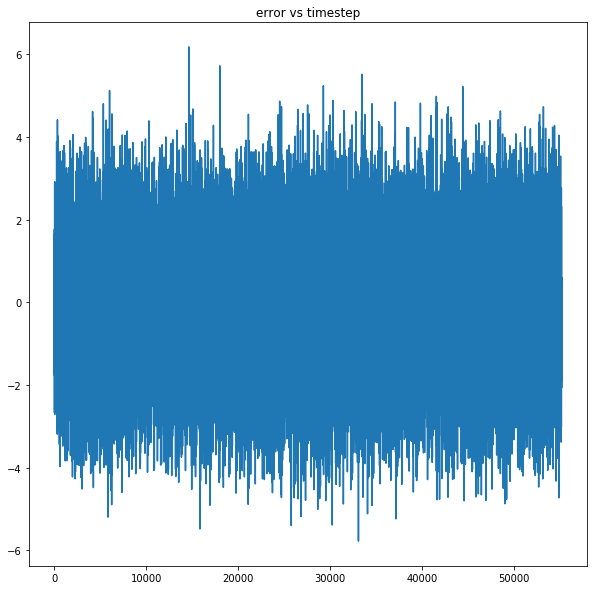

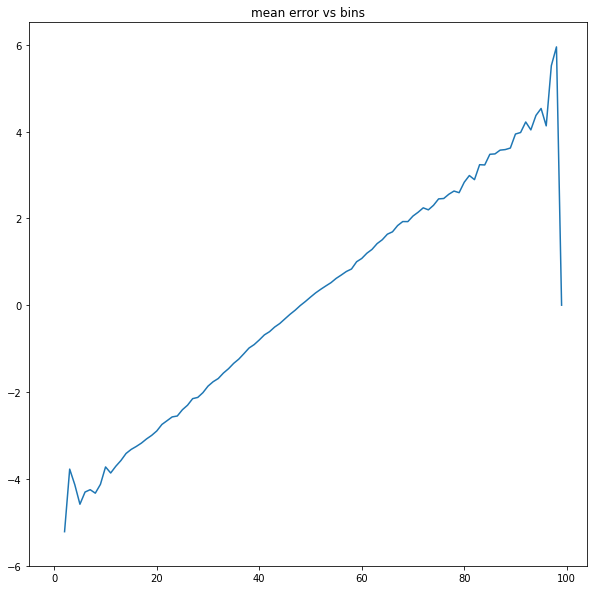

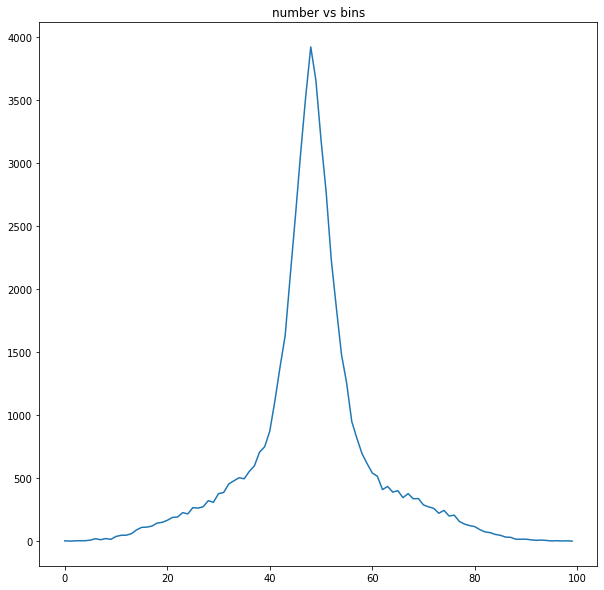

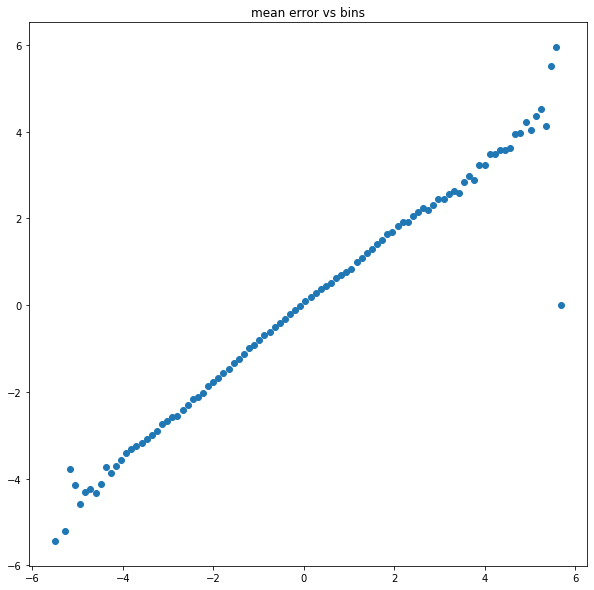

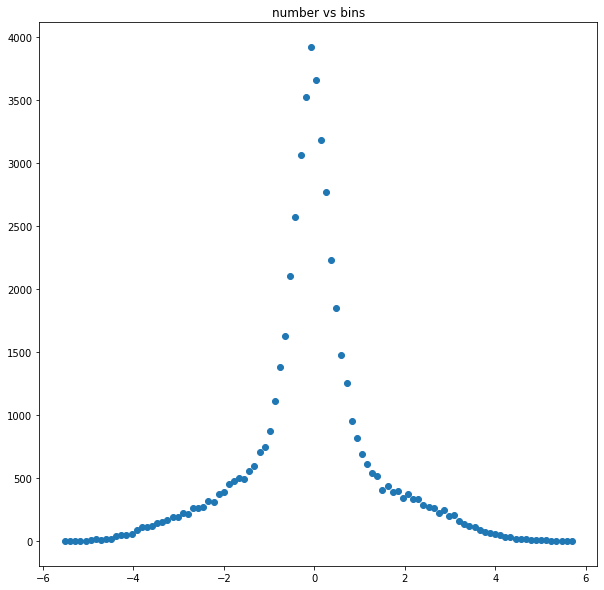

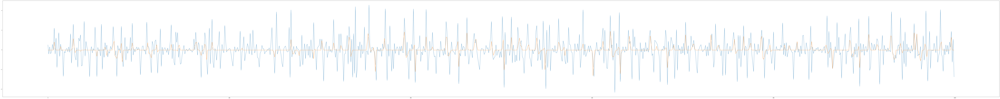

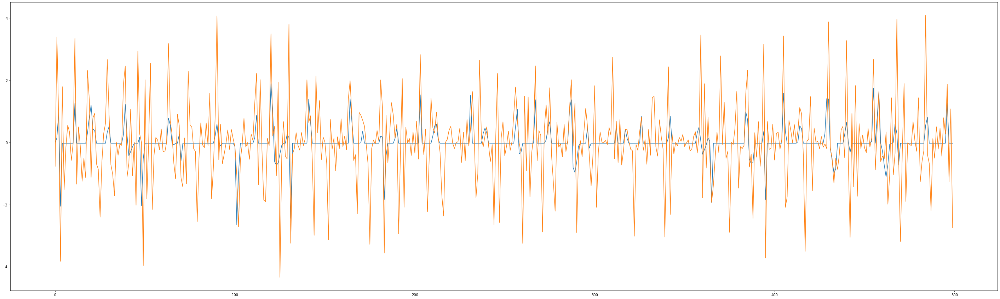

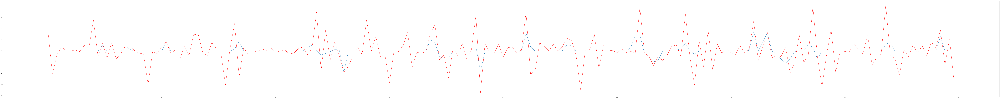

In [20]:
model.save('custom_loss_1')

y_pred = model.predict(X_test[1:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_diff_log, y_pred[:,0],100)


#print(X_val_scaled, y_val_log.values, results)
plt.figure(figsize=(200,20))

plt.plot(y_val_diff_log[:1000])
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_diff_log[500:1000])
plt.show()

plt.figure(figsize=(200,20))
plt.plot(y_pred[800:1000,0])
plt.plot(y_val_diff_log[800:1000],'r')
plt.show()

In [21]:
import tensorflow as tf
tf.keras.metrics.MeanSquaredError

model = tf.keras.models.load_model('logdiff_and_log')

import keras.backend as K

def custom_metric(y_true,y_pred):
        return K.mean(((K.square(y_pred[:,0] - y_true[:,0]))))   
    


def custom_loss(y_true,y_pred):
        return K.mean(((K.square(y_pred[:,0] - y_true[:,0])))) + 4*K.mean(((K.square(y_pred[:,1] - y_true[:,1]))))

In [23]:
model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(2))

# #compile model using accuracy to measure model performance
model.compile(loss=custom_loss, optimizer='adam',  batch_size=8192, metrics = [custom_metric, 'mse']) #metrics=[tf.keras.metrics.MeanSquaredError()])

Y_train = np.zeros((y_train_diff_log.shape[0],2))
Y_test = np.zeros((y_val_diff_log.shape[0],2))
Y_train[:,0]=y_train_log[1:]
Y_train[:,1]=y_train_diff_log
Y_test[:,0]=y_val_log[1:]
Y_test[:,1]=y_val_diff_log


model.fit(X[1:,:], Y_train, validation_data=(X_test[1:,:], Y_test),  batch_size = 8192, epochs=40)

Train on 1838282 samples, validate on 55209 samples
Epoch 1/40
1838282/1838282 [==============================] - 6s 3us/step - loss: 16.6215 - custom_metric: 11.0897 - mse: 6.2447 - val_loss: 9.7130 - val_custom_metric: 2.8167 - val_mse: 2.2741
Epoch 2/40
1838282/1838282 [==============================] - 6s 3us/step - loss: 6.4988 - custom_metric: 1.9576 - mse: 1.5468 - val_loss: 8.9048 - val_custom_metric: 2.0701 - val_mse: 1.8903
Epoch 3/40
1838282/1838282 [==============================] - 6s 3us/step - loss: 5.9090 - custom_metric: 1.4115 - mse: 1.2680 - val_loss: 8.6823 - val_custom_metric: 1.8717 - val_mse: 1.7877
Epoch 4/40
1838282/1838282 [==============================] - 6s 3us/step - loss: 5.7872 - custom_metric: 1.3026 - mse: 1.2119 - val_loss: 8.5324 - val_custom_metric: 1.7359 - val_mse: 1.7180
Epoch 5/40
1838282/1838282 [==============================] - 6s 3us/step - loss: 5.6457 - custom_metric: 1.1750 - mse: 1.1464 - val_loss: 8.3935 - val_custom_metric: 1.6268 - va

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.9451885 median ytrue 8.318118323312142


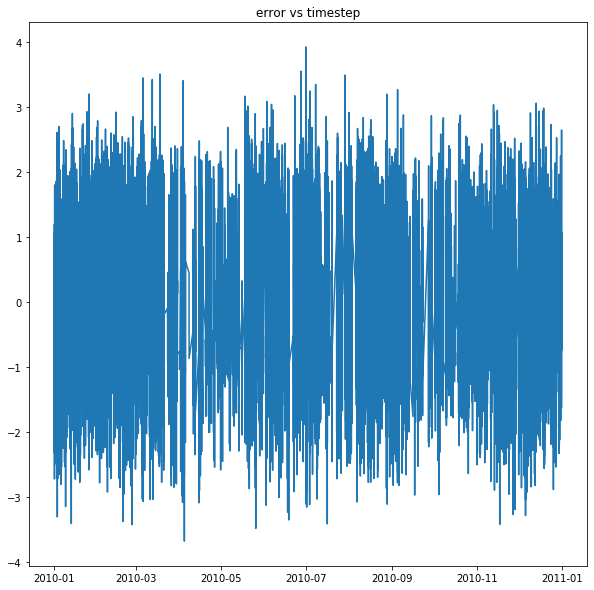

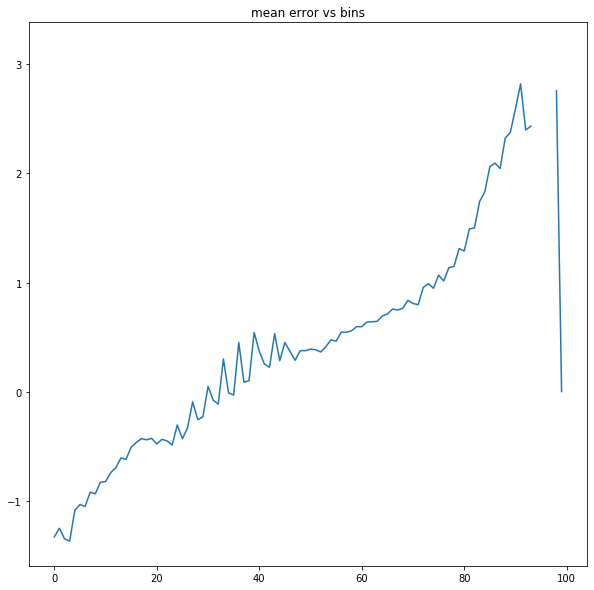

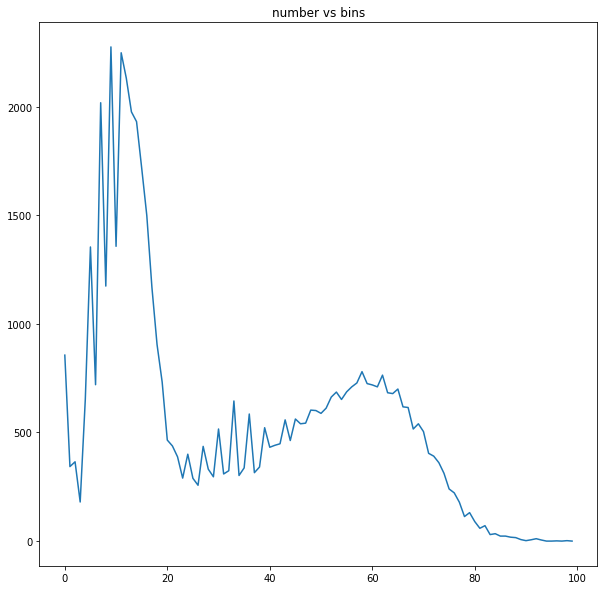

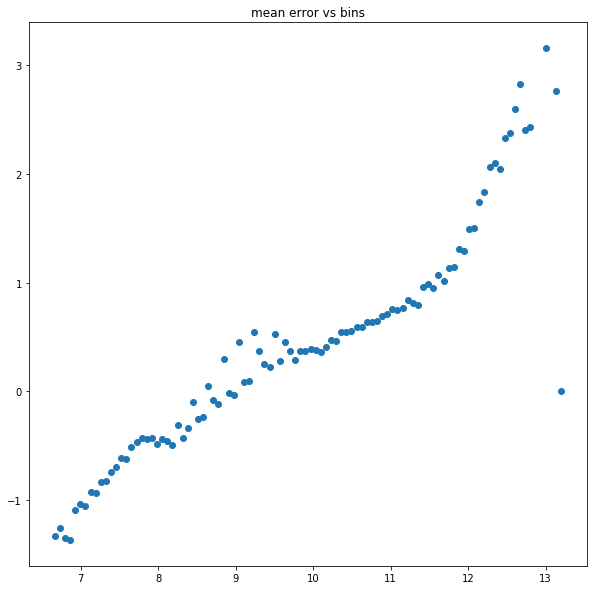

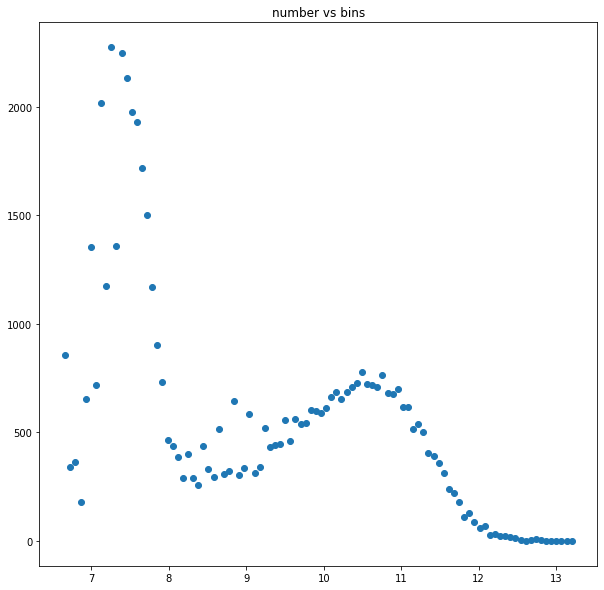

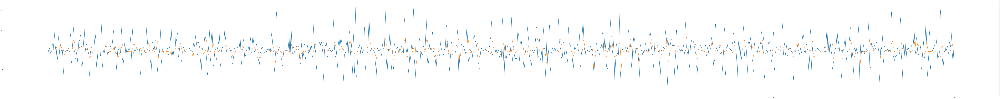

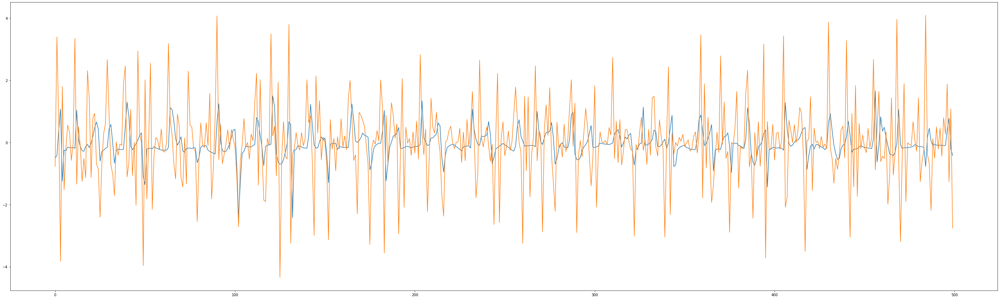

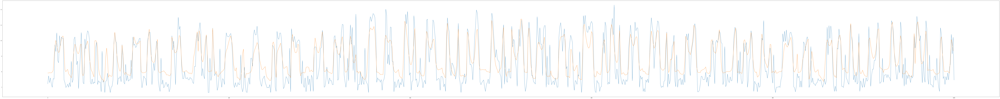

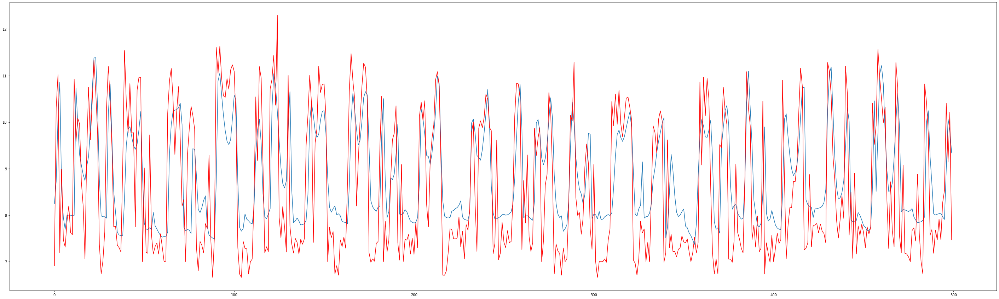

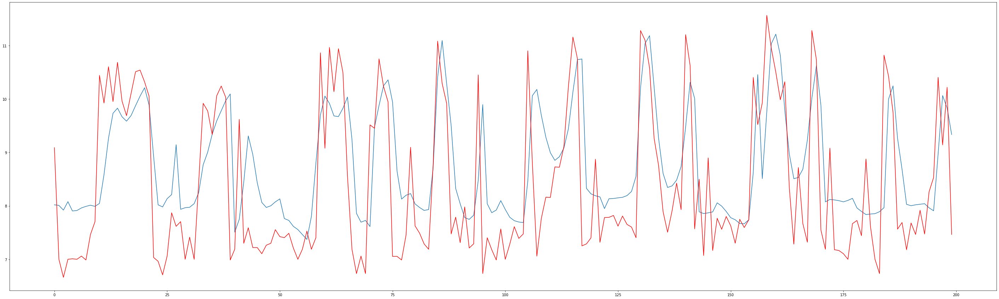

In [24]:

model.save('custom2_loss_4')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)



#print(X_val_scaled, y_val_log.values, results)
plt.figure(figsize=(200,20))

plt.plot(y_val_diff_log[:1000])
plt.plot(y_pred[0:1000,1])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,1])
plt.plot(y_val_diff_log[500:1000])
plt.show()

plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1001].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[501:1001].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[801:1001].values,'r')
plt.show()


In [25]:
import keras.backend as K

def custom_loss(y_true,y_pred):

        return K.mean(K.sum(K.square(K.square(y_pred - y_true))))
   



In [26]:

model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

#compile model using accuracy to measure model performance
model.compile(loss='mae', optimizer='adam', metrics=['mse'])
model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), batch_size=8192,epochs=40)


Train on 1838283 samples, validate on 55210 samples
Epoch 1/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 9.0219 - mse: 82.8679 - val_loss: 8.5948 - val_mse: 76.2152
Epoch 2/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 8.7883 - mse: 78.6828 - val_loss: 8.3695 - val_mse: 72.3940
Epoch 3/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 8.5632 - mse: 74.7756 - val_loss: 8.1444 - val_mse: 68.6762
Epoch 4/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 8.3381 - mse: 70.9709 - val_loss: 7.9193 - val_mse: 65.0605
Epoch 5/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 8.1130 - mse: 67.2685 - val_loss: 7.6943 - val_mse: 61.5466
Epoch 6/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 7.8879 - mse: 63.6674 - val_loss: 7.4692 - val_mse: 58.1342
Epoch 7/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 7.6629 - mse: 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.512245 median ytrue 8.318118323312142


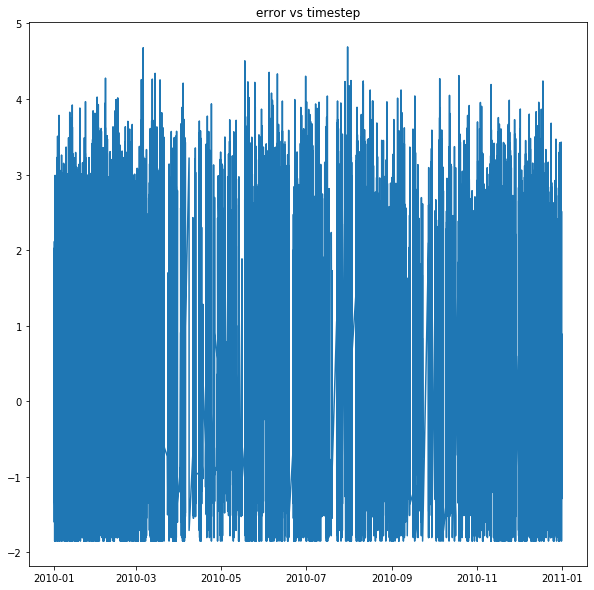

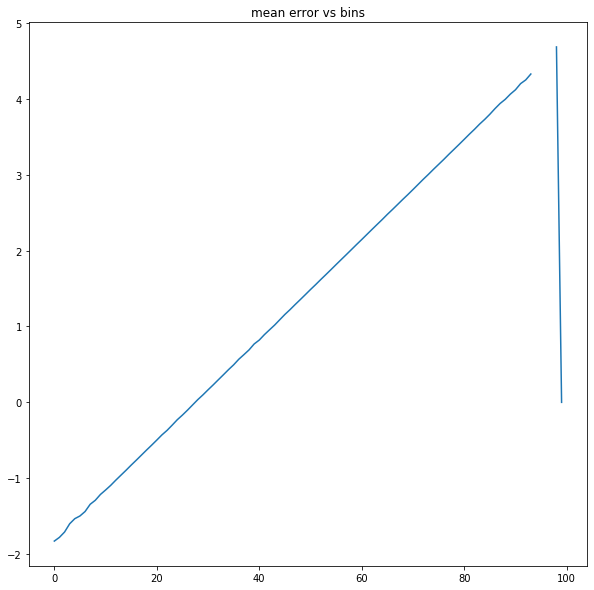

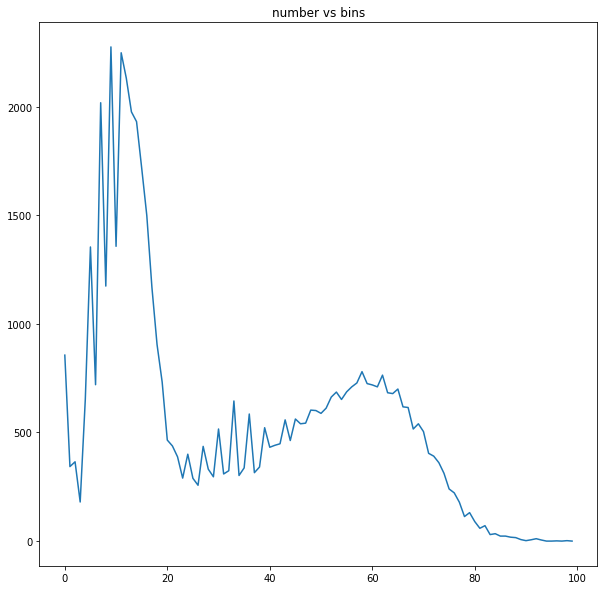

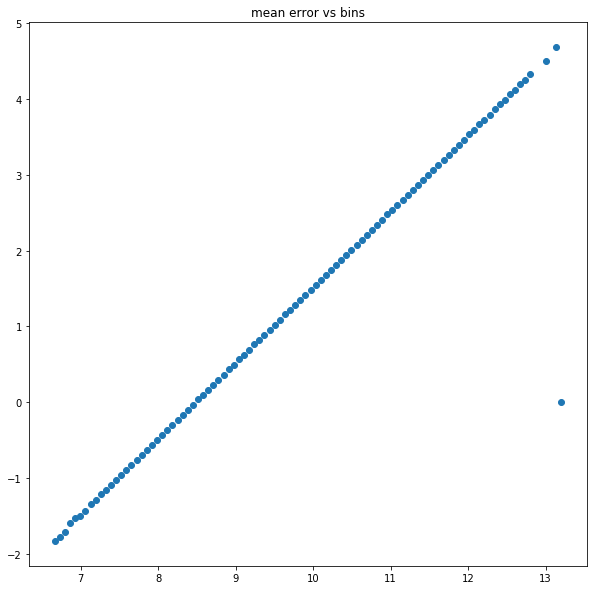

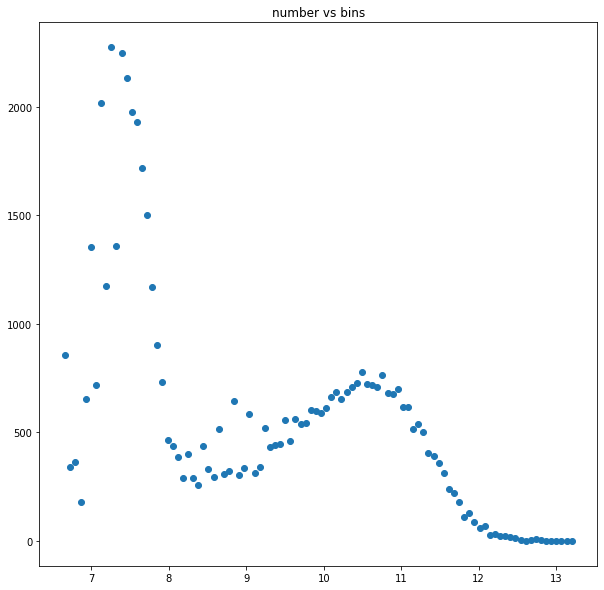

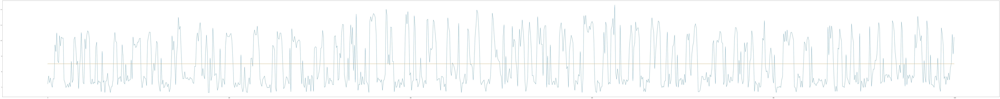

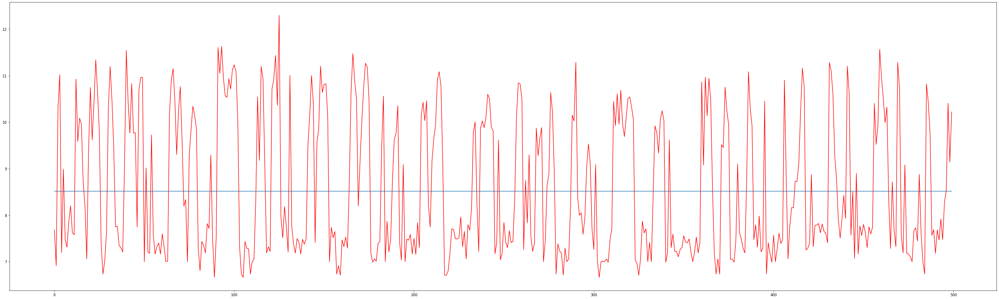

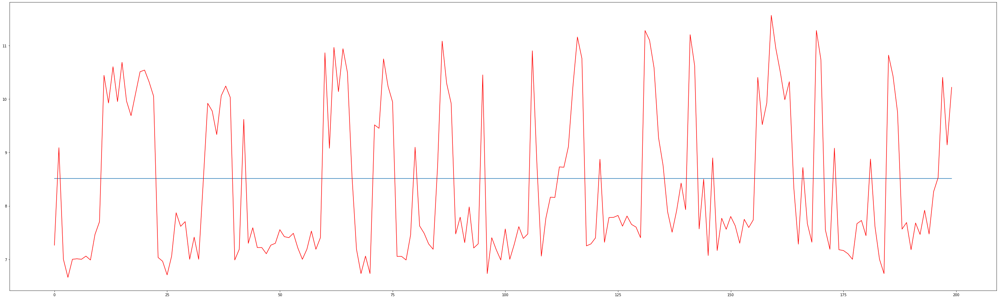

In [27]:
model.save('custom_loss2_7')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

In [28]:
X1=X.reshape((X.shape[0],1,148))
X_test1=X_test.reshape((X_test.shape[0],1,148))


input1 = Input(shape=(1,148))

model=Dense(int(32), activation='relu')(input1)

merged=TimeDistributed(Flatten())(model)
merged=LSTM(8,activation='relu')(merged)

output = Dense(4, activation='relu')(merged)
output = Dense(1)(output)

merged_model = Model(inputs = input1, outputs =output )
merged_model.compile(loss='mae', optimizer='adam', metrics=['mse'])
merged_model.summary()
merged_model.fit(X1, y_train_log, validation_data=(X_test1, y_val_log),batch_size=8192, epochs=40)


Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 1, 148)            0         
_________________________________________________________________
dense_21 (Dense)             (None, 1, 32)             4768      
_________________________________________________________________
time_distributed_1 (TimeDist (None, 1, 32)             0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_22 (Dense)             (None, 4)                 36        
_________________________________________________________________
dense_23 (Dense)             (None, 1)                 5         
Total params: 6,121
Trainable params: 6,121
Non-trainable params: 0
_________________________________________________________

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.928043 median ytrue 8.318118323312142


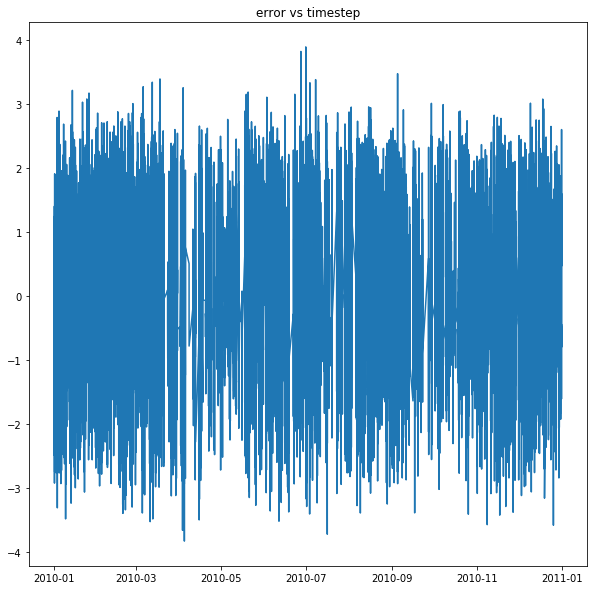

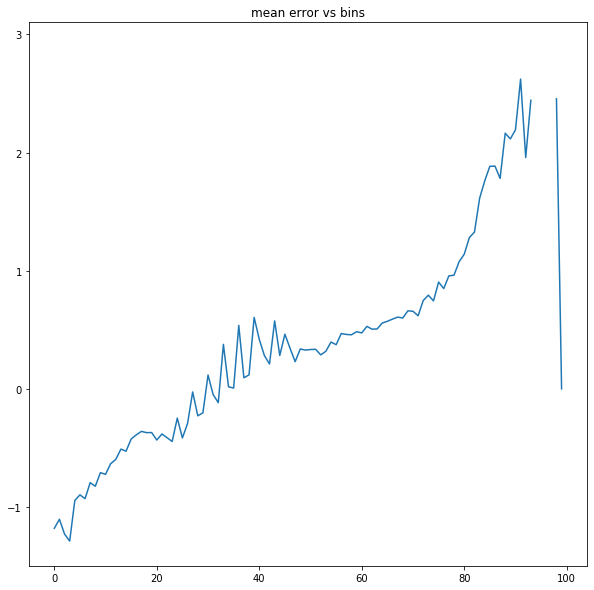

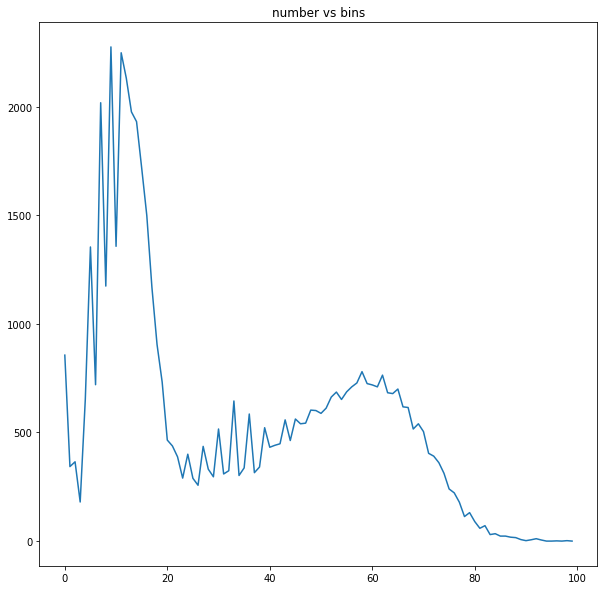

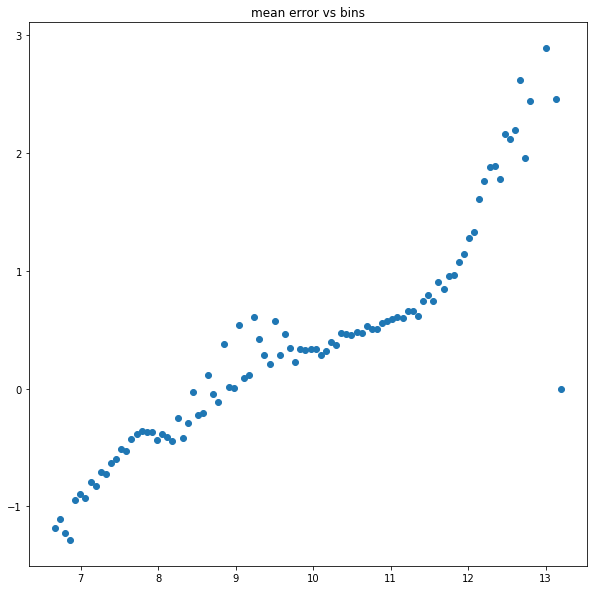

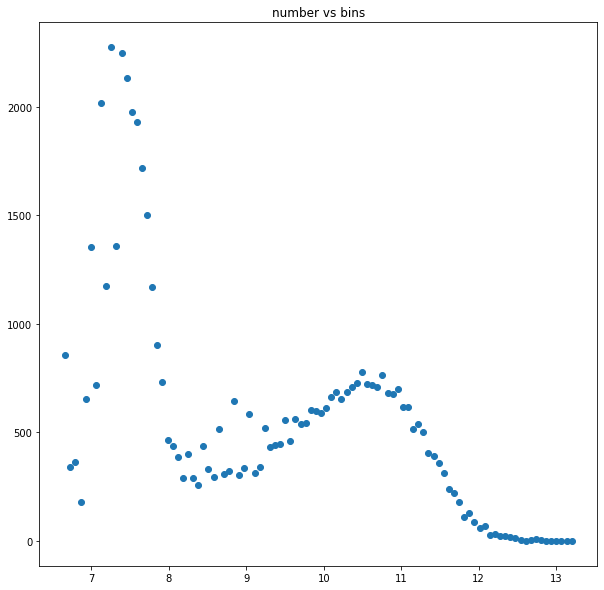

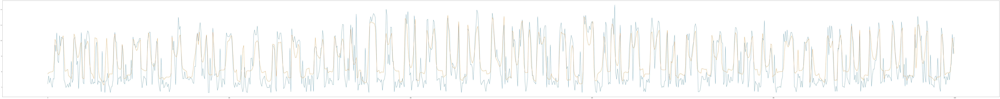

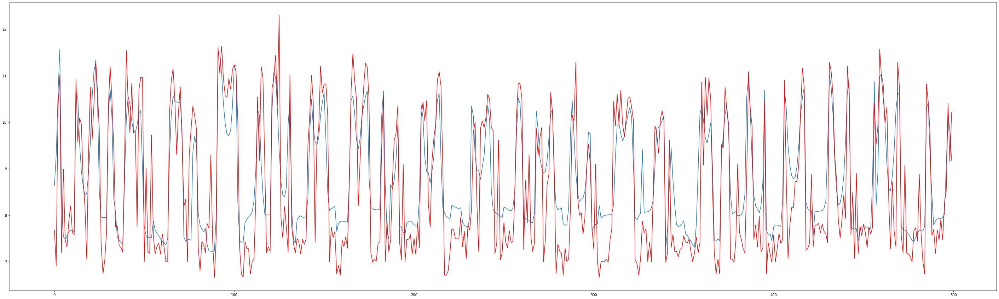

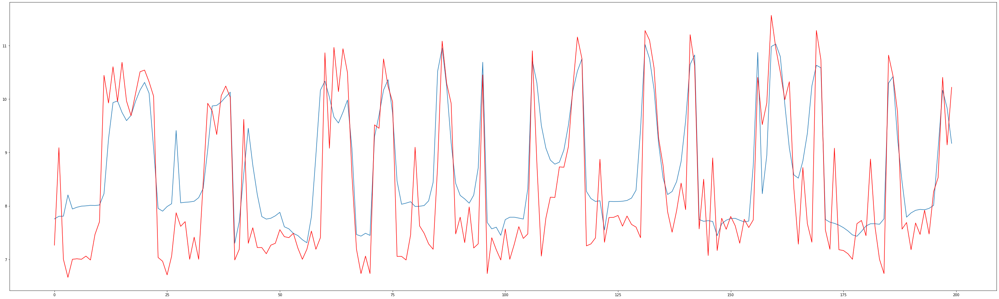

In [29]:
merged_model.save('custom_loss2_8')

y_pred = merged_model.predict(X_test1[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

In [30]:
X1=X.reshape((X.shape[0],1,148))
X_test1=X_test.reshape((X_test.shape[0],1,148))


input1 = Input(shape=(1,148))

model=Dense(int(148), activation='relu')(input1)

merged=TimeDistributed(Flatten())(input1)
merged=LSTM(32,activation='relu')(merged)

output = Dense(4, activation='relu')(merged)
output = Dense(1)(output)

merged_model = Model(inputs = input1, outputs =output )
merged_model.compile(loss='mae', optimizer='adam', metrics=['mse'])
merged_model.summary()
merged_model.fit(X1, y_train_log, validation_data=(X_test1, y_val_log), batch_size=8192,epochs=40)


Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 1, 148)            0         
_________________________________________________________________
time_distributed_2 (TimeDist (None, 1, 148)            0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                23168     
_________________________________________________________________
dense_25 (Dense)             (None, 4)                 132       
_________________________________________________________________
dense_26 (Dense)             (None, 1)                 5         
Total params: 23,305
Trainable params: 23,305
Non-trainable params: 0
_________________________________________________________________
Train on 1838283 samples, validate on 55210 samples
Epoch 1/40
1838283/1838283 [==============================] - 8s 5us/

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.512082 median ytrue 8.318118323312142


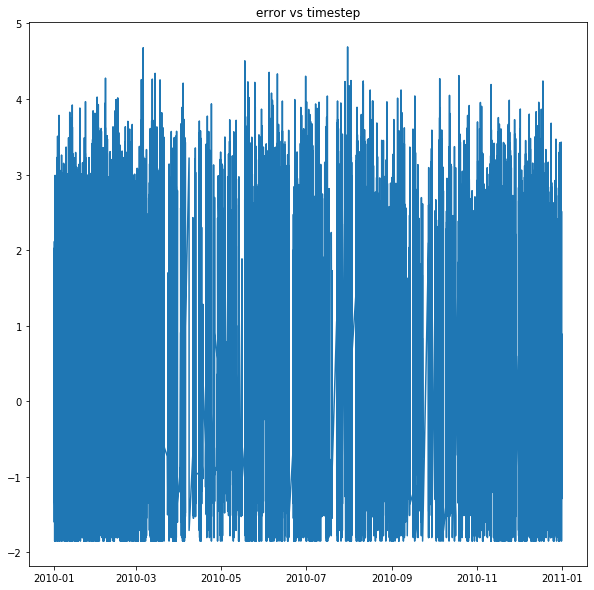

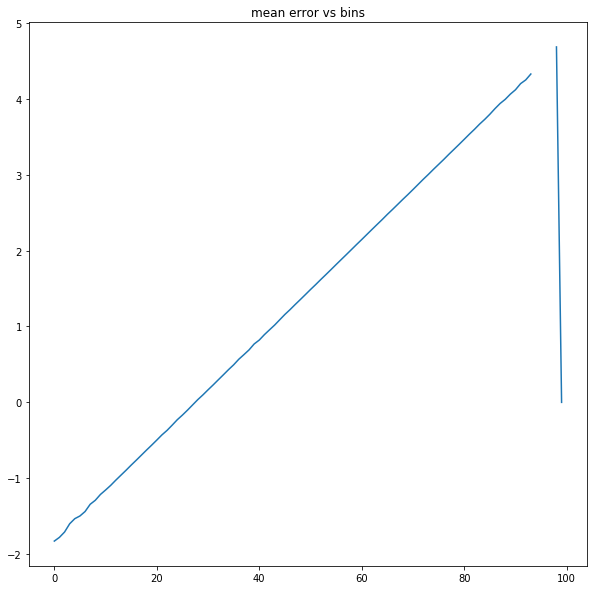

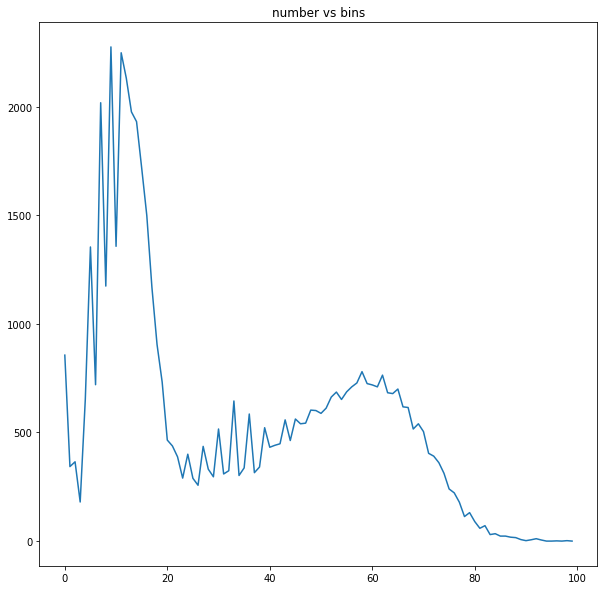

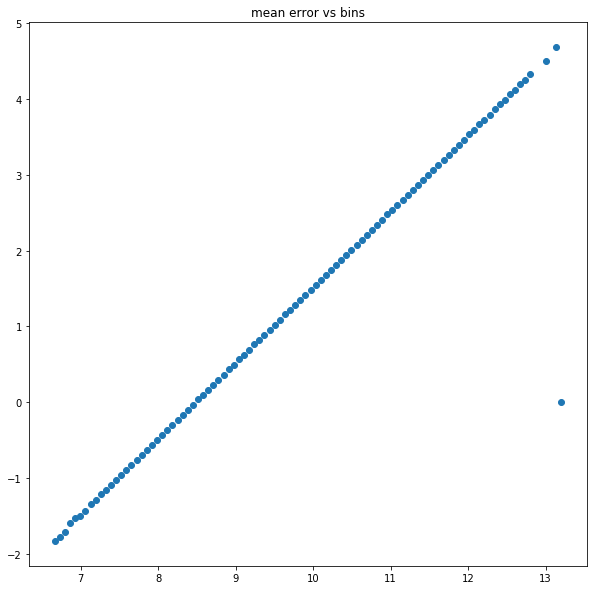

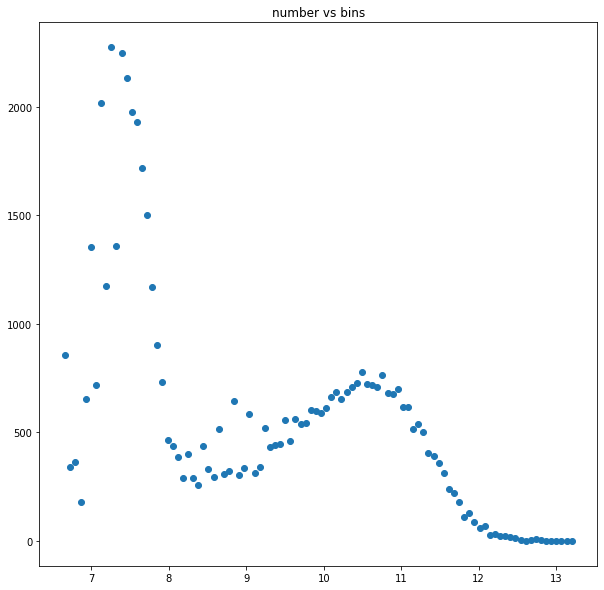

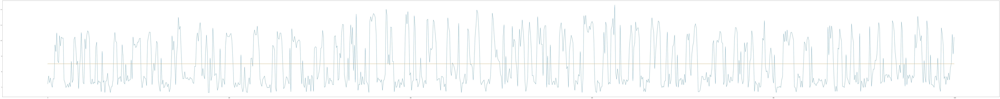

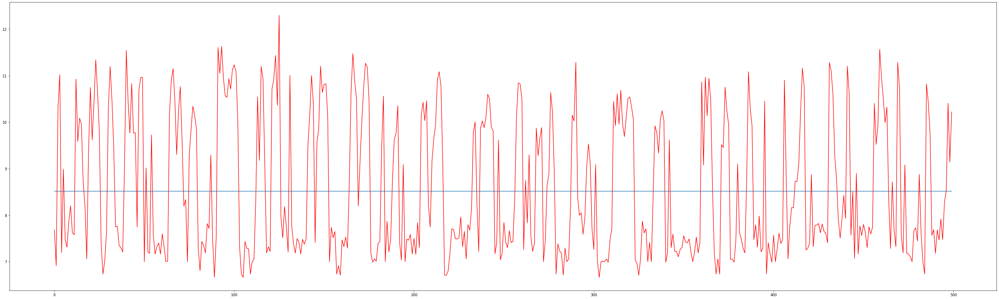

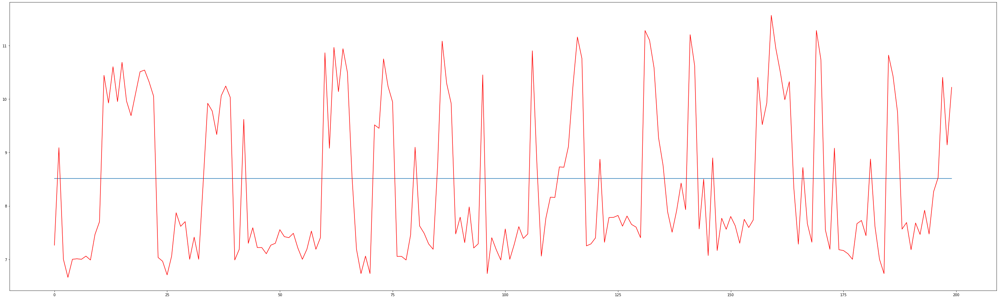

In [31]:
merged_model.save('custom_loss2_9')

y_pred = merged_model.predict(X_test1[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

In [32]:
from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten
#create model
model = Sequential()

model.add(Dense(int(32), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])

model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), batch_size=128,epochs=40)

Train on 1838283 samples, validate on 55210 samples
Epoch 1/40
1838283/1838283 [==============================] - 25s 14us/step - loss: 2.3475 - mse: 2.3476 - val_loss: 0.9313 - val_mse: 0.9313
Epoch 2/40
1838283/1838283 [==============================] - 20s 11us/step - loss: 0.5613 - mse: 0.5613 - val_loss: 0.9318 - val_mse: 0.9318
Epoch 3/40
1838283/1838283 [==============================] - 18s 10us/step - loss: 0.5290 - mse: 0.5290 - val_loss: 0.7937 - val_mse: 0.7937
Epoch 4/40
1838283/1838283 [==============================] - 24s 13us/step - loss: 0.5139 - mse: 0.5139 - val_loss: 0.7864 - val_mse: 0.7864
Epoch 5/40
1838283/1838283 [==============================] - 24s 13us/step - loss: 0.5011 - mse: 0.5011 - val_loss: 0.7559 - val_mse: 0.7559
Epoch 6/40
1838283/1838283 [==============================] - 26s 14us/step - loss: 0.4929 - mse: 0.4929 - val_loss: 0.7411 - val_mse: 0.7411
Epoch 7/40
1838283/1838283 [==============================] - 26s 14us/step - loss: 0.4862 - mse

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.865005 median ytrue 8.318118323312142


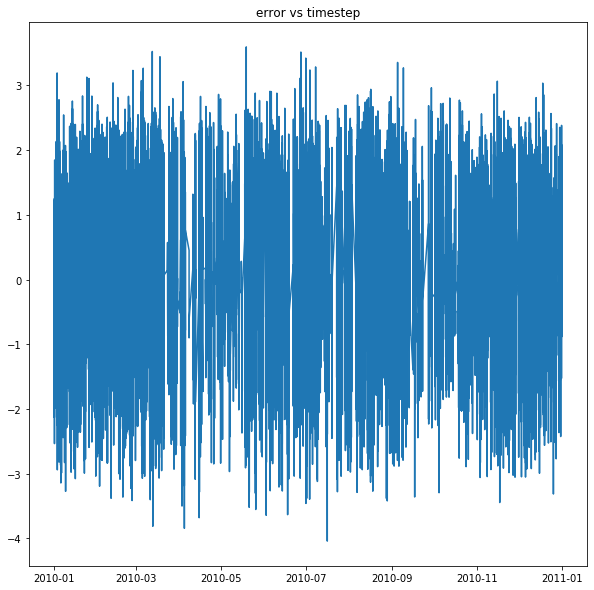

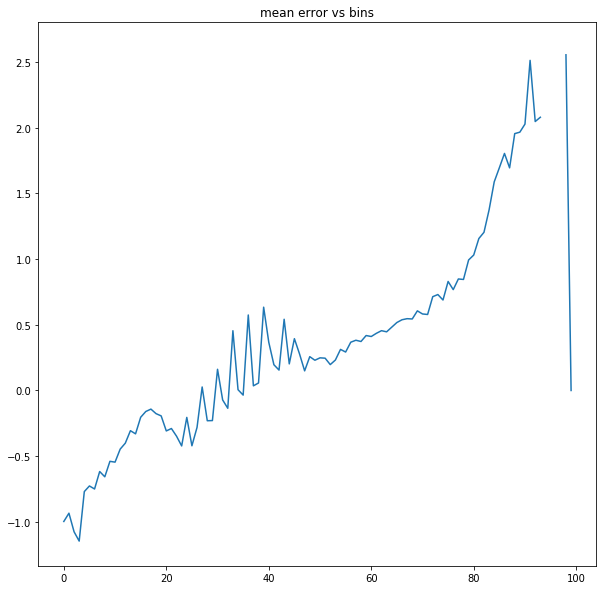

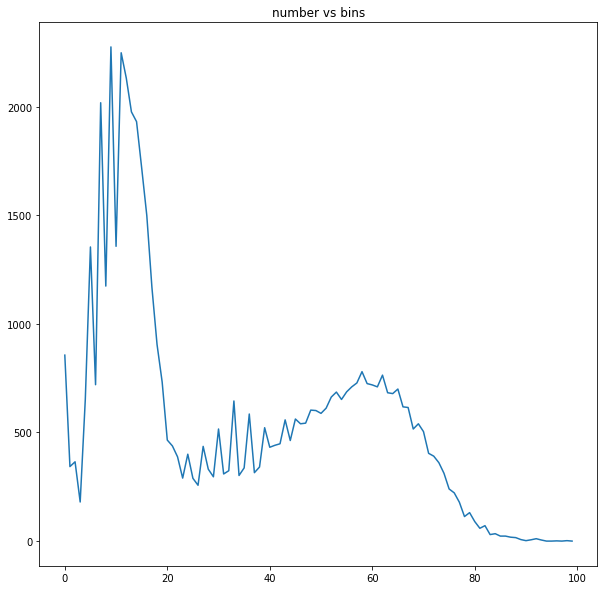

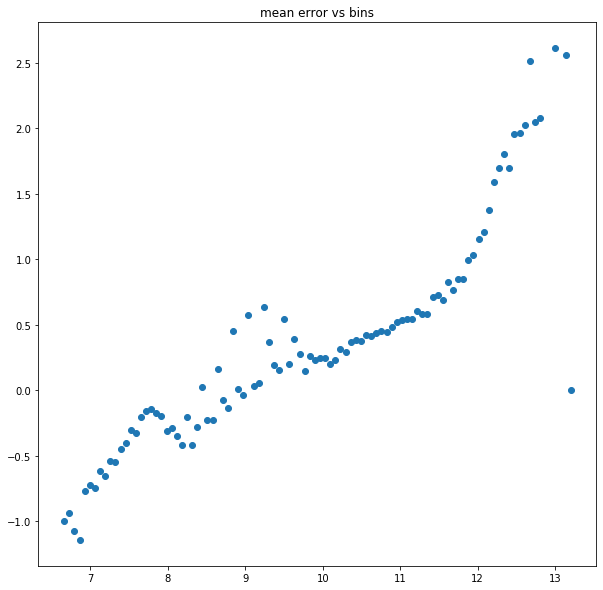

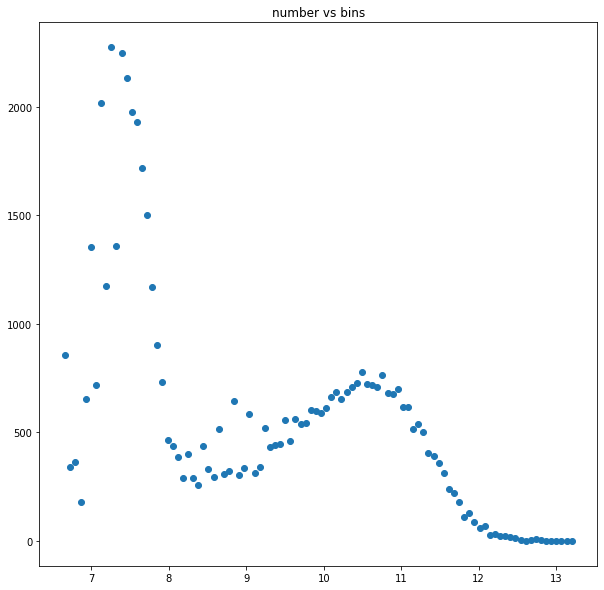

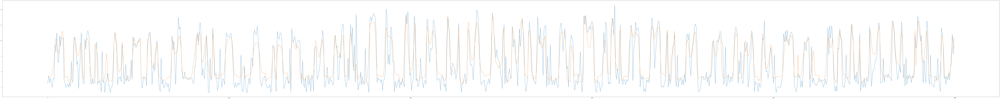

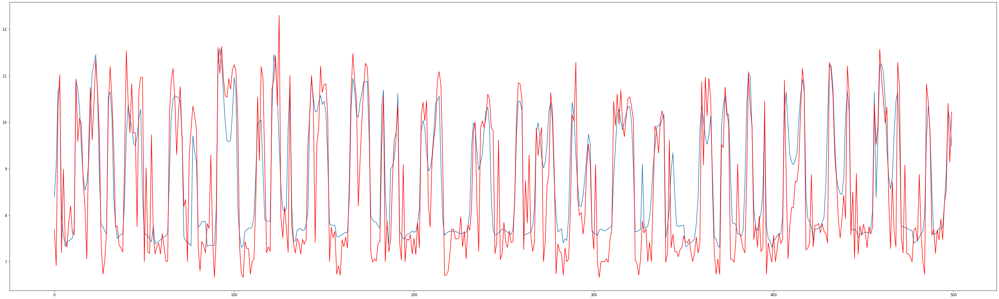

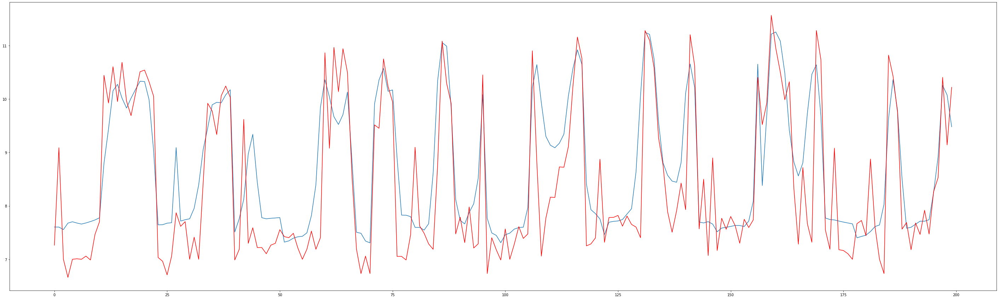

In [33]:
model.save('custom_loss2_10')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

In [34]:
from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten
#create model
model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

#compile model using accuracy to measure model performance
model.compile(loss='mae', optimizer='adam', metrics=['mse'])

model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), batch_size=8192, epochs=100)

Train on 1838283 samples, validate on 55210 samples
Epoch 1/100
1838283/1838283 [==============================] - 9s 5us/step - loss: 2.1180 - mse: 18.8263 - val_loss: 1.2383 - val_mse: 2.2261
Epoch 2/100
1838283/1838283 [==============================] - 9s 5us/step - loss: 0.9356 - mse: 2.3944 - val_loss: 1.1216 - val_mse: 1.7628
Epoch 3/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.8505 - mse: 1.2715 - val_loss: 1.0933 - val_mse: 1.6679
Epoch 4/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.7938 - mse: 1.0614 - val_loss: 0.9509 - val_mse: 1.2730
Epoch 5/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.6355 - mse: 0.7105 - val_loss: 0.7904 - val_mse: 0.9233
Epoch 6/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.5781 - mse: 0.6298 - val_loss: 0.7547 - val_mse: 0.8550
Epoch 7/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.5554 - mse: 0.58

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.737779 median ytrue 8.318118323312142


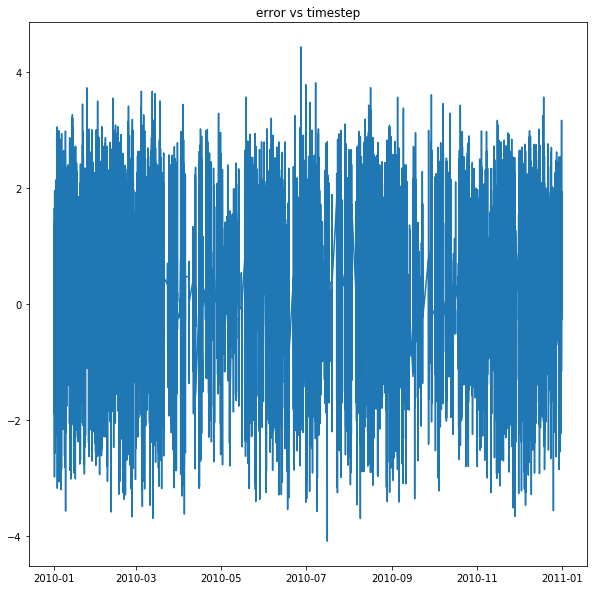

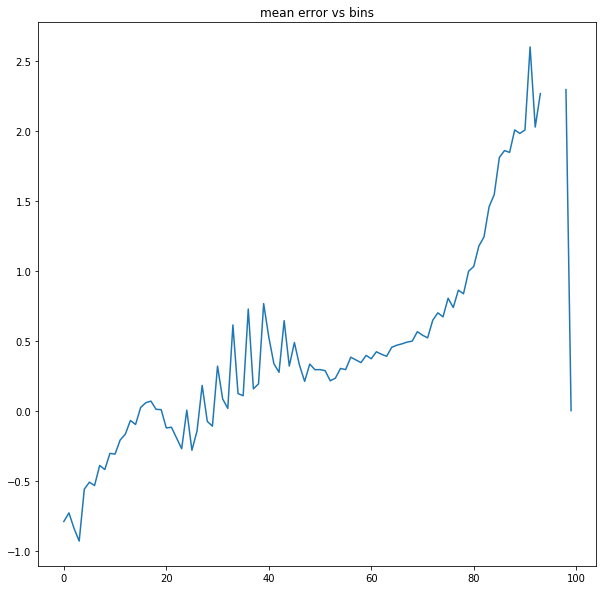

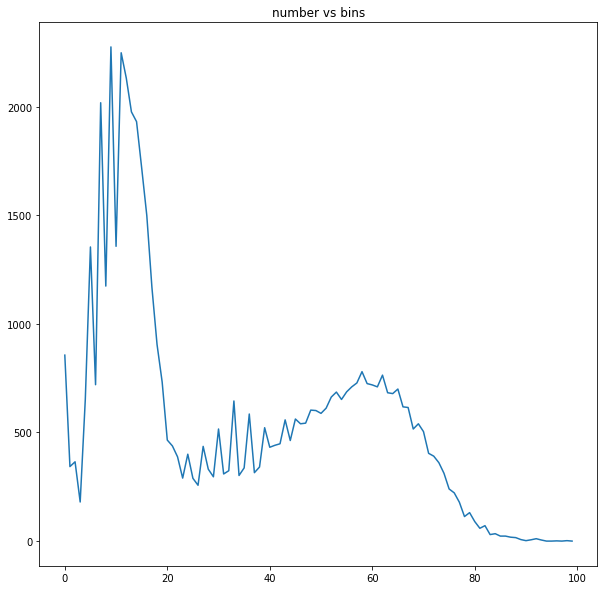

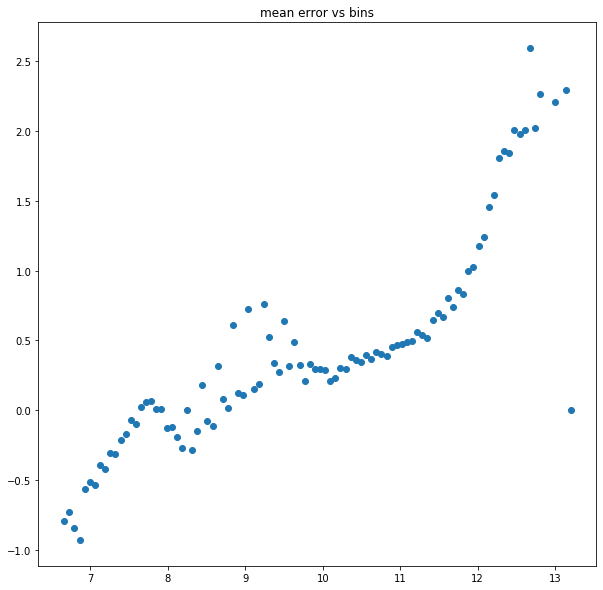

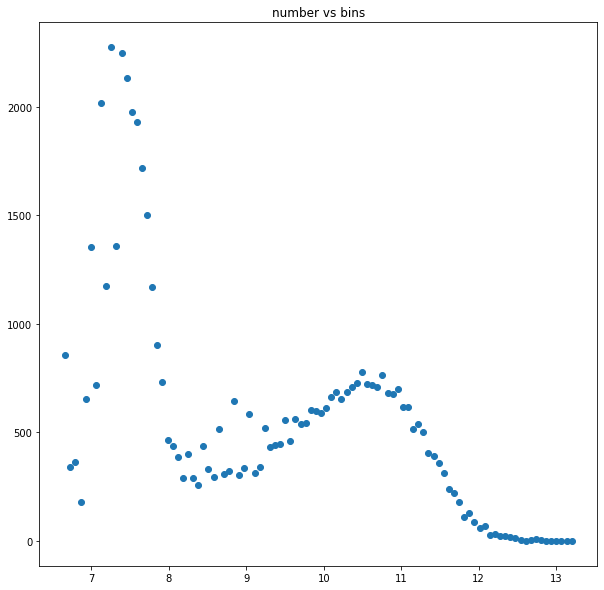

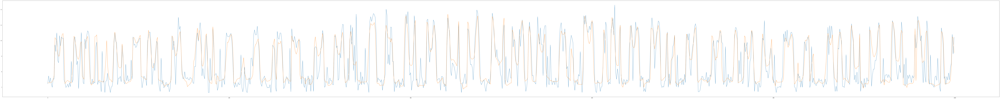

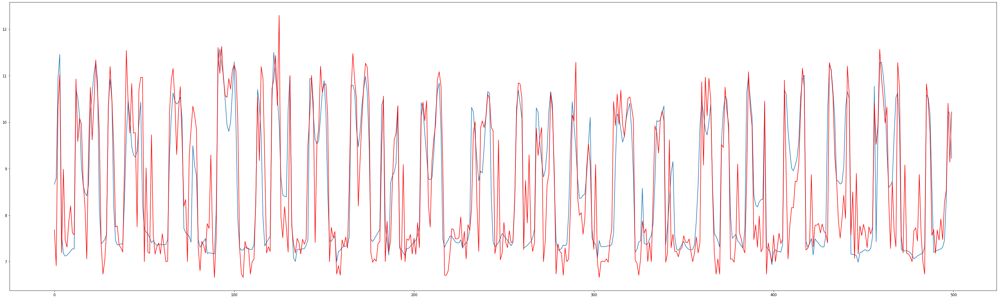

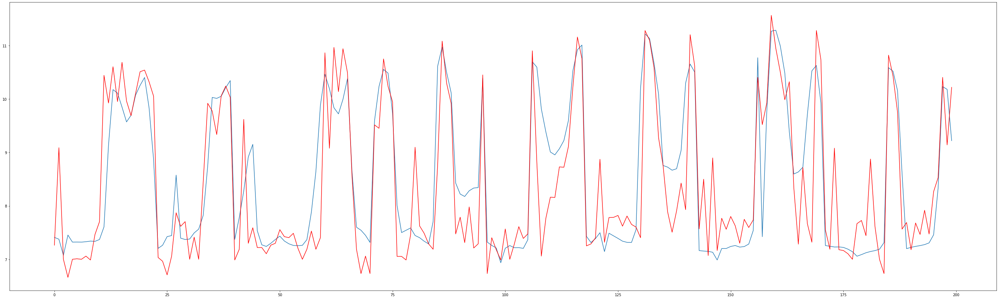

In [35]:
model.save('custom_loss2_11')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

In [36]:
def tilted_loss(q,y,f):
    e = (y-f)
    return K.mean(K.maximum(q*e, (q-1)*e), axis=-1)

In [41]:
#create model
model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

#     model.compile(loss=lambda y,f: tilted_loss(q,y,f), optimizer='adadelta')
#     model.fit(mcycle.times.values, mcycle.accel.values, epochs=2000, batch_size=32, verbose=0)
    
q=.8
#compile model using accuracy to measure model performance
model.compile(loss=lambda y,f: tilted_loss(q,y,f), optimizer='adam',  metrics=['mse'])

model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)),batch_size=8192, epochs=40)

Train on 1838283 samples, validate on 55210 samples
Epoch 1/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 1.2077 - mse: 79.2443 - val_loss: 0.4674 - val_mse: 5.3539
Epoch 2/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 0.3872 - mse: 12.1513 - val_loss: 0.3785 - val_mse: 3.5307
Epoch 3/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 0.3124 - mse: 3.8621 - val_loss: 0.3545 - val_mse: 3.1641
Epoch 4/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 0.2939 - mse: 2.5796 - val_loss: 0.3461 - val_mse: 3.1613
Epoch 5/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 0.2810 - mse: 2.2284 - val_loss: 0.3329 - val_mse: 2.9694
Epoch 6/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 0.2456 - mse: 1.6998 - val_loss: 0.2675 - val_mse: 1.6756
Epoch 7/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 0.2076 - mse: 1.1785 - v

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 9.281685 median ytrue 8.318118323312142


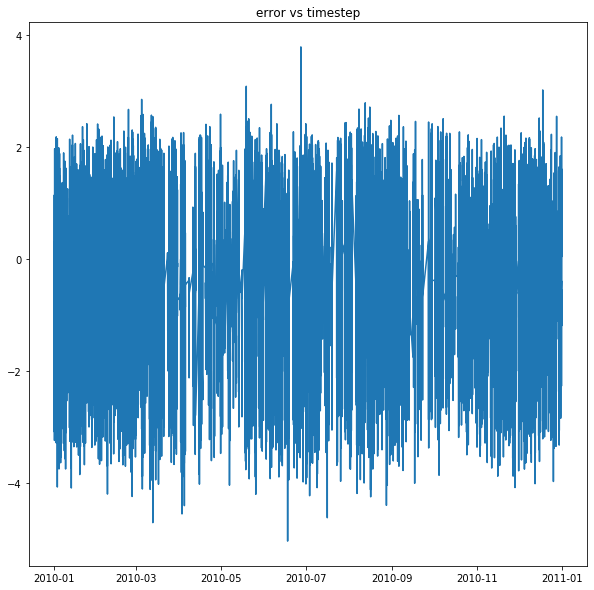

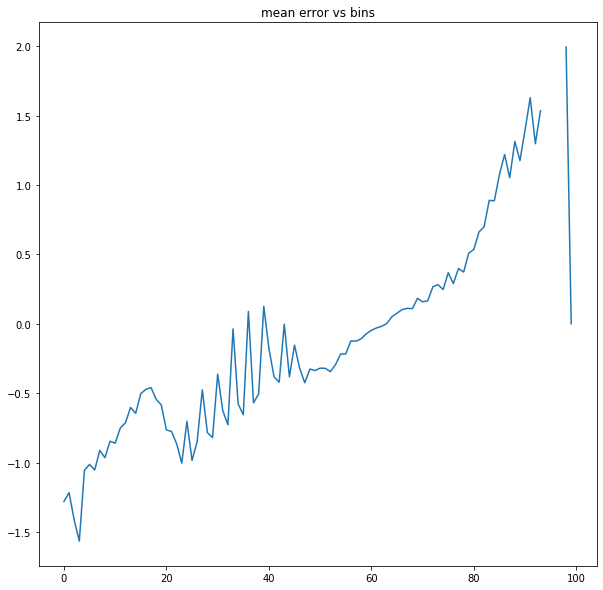

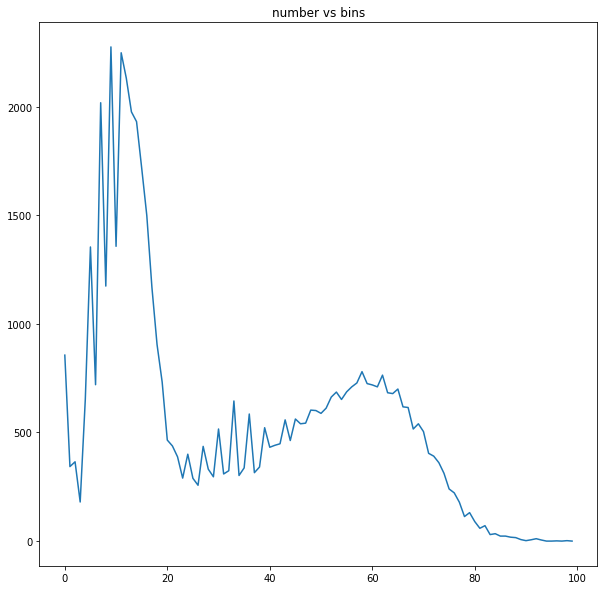

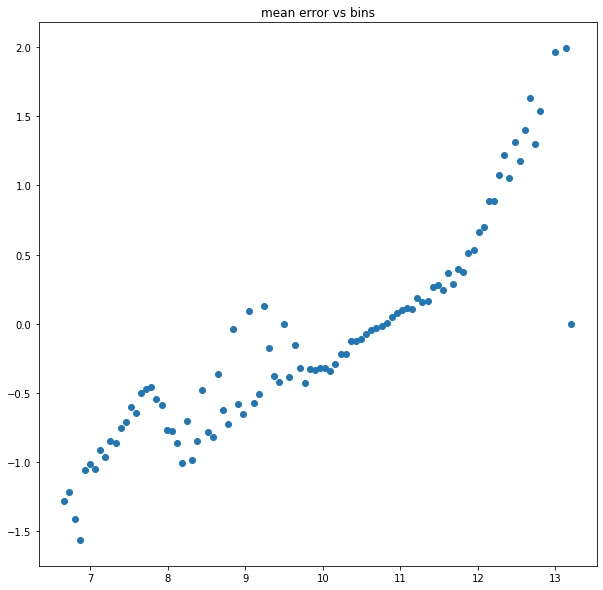

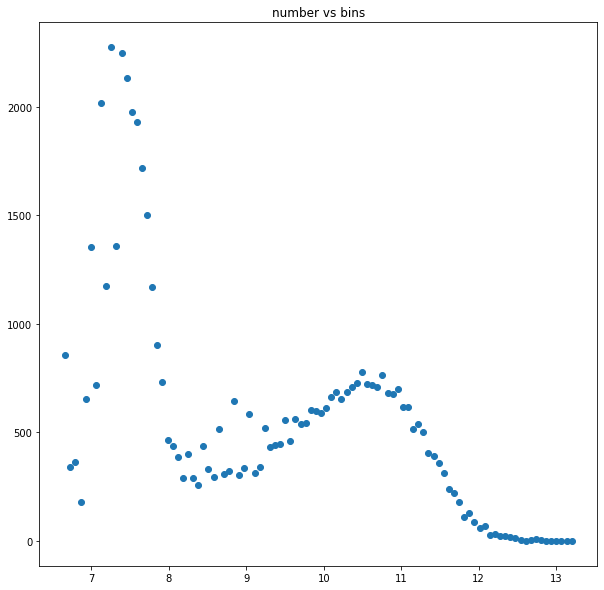

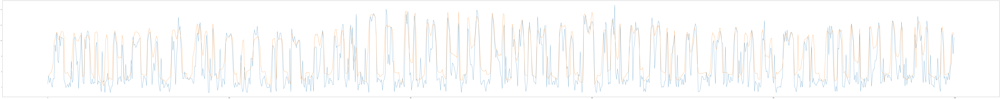

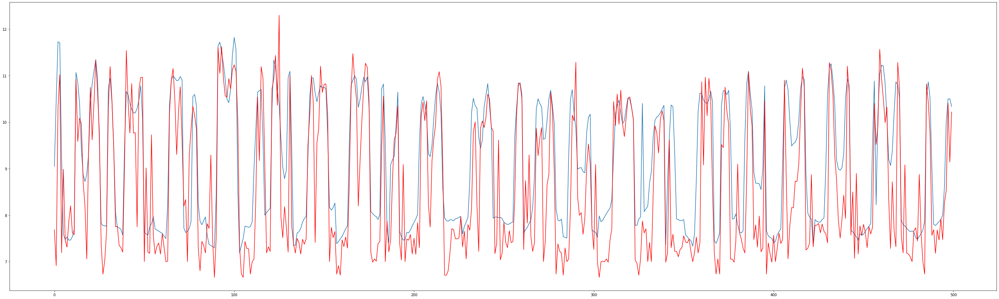

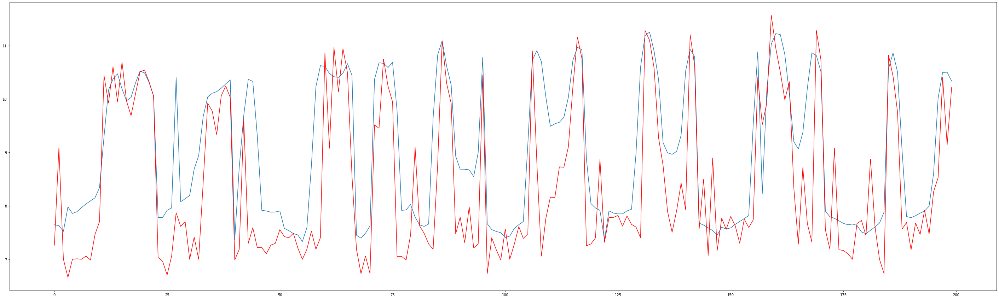

In [42]:
model.save('custom_loss2_12')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

In [49]:
model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',  metrics=['mse'])

model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), batch_size=8192,epochs=100)

Train on 1838283 samples, validate on 55210 samples
Epoch 1/100
1838283/1838283 [==============================] - 33s 18us/step - loss: 9.2965 - mse: 9.2965 - val_loss: 2.7084 - val_mse: 2.7084
Epoch 2/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 2.1950 - mse: 2.1950 - val_loss: 2.0687 - val_mse: 2.0687
Epoch 3/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 1.3820 - mse: 1.3820 - val_loss: 1.8423 - val_mse: 1.8423
Epoch 4/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 1.2430 - mse: 1.2430 - val_loss: 1.7220 - val_mse: 1.7220
Epoch 5/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 1.2419 - mse: 1.2419 - val_loss: 1.5716 - val_mse: 1.5716
Epoch 6/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 1.0158 - mse: 1.0158 - val_loss: 1.4102 - val_mse: 1.4102
Epoch 7/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.8784 - mse: 0.8

1838283/1838283 [==============================] - 7s 4us/step - loss: 0.4504 - mse: 0.4504 - val_loss: 0.6651 - val_mse: 0.6651
Epoch 59/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.4451 - mse: 0.4451 - val_loss: 0.6680 - val_mse: 0.6680
Epoch 60/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.4470 - mse: 0.4470 - val_loss: 0.6606 - val_mse: 0.6606
Epoch 61/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.4427 - mse: 0.4427 - val_loss: 0.6585 - val_mse: 0.6585
Epoch 62/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.4422 - mse: 0.4422 - val_loss: 0.6553 - val_mse: 0.6553
Epoch 63/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.4425 - mse: 0.4425 - val_loss: 0.6682 - val_mse: 0.6682
Epoch 64/100
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.4445 - mse: 0.4445 - val_loss: 0.6509 - val_mse: 0.6509
Epoch 65/100
183828

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.85357 median ytrue 8.318118323312142


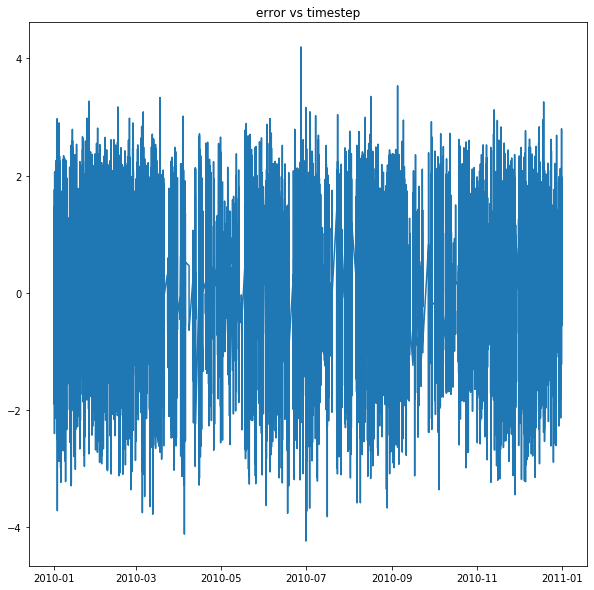

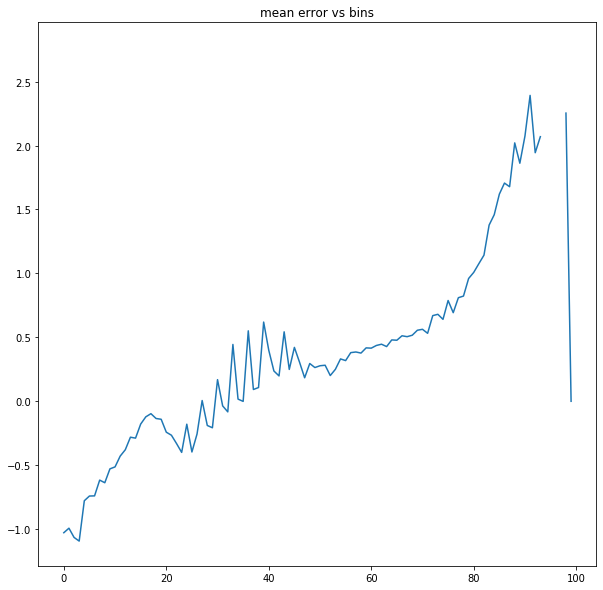

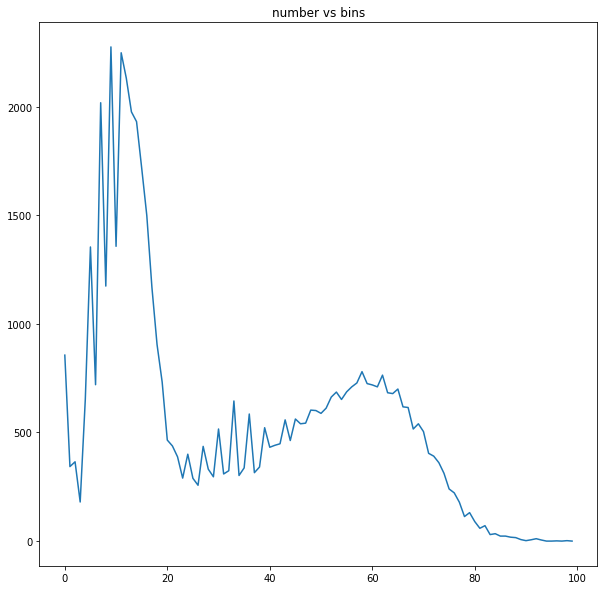

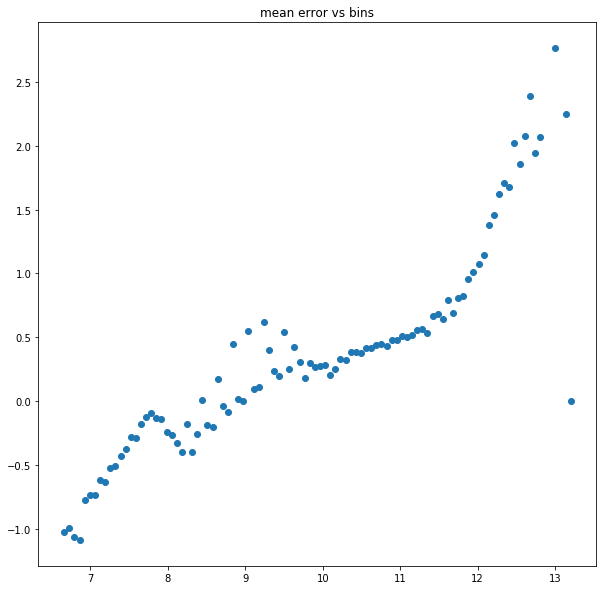

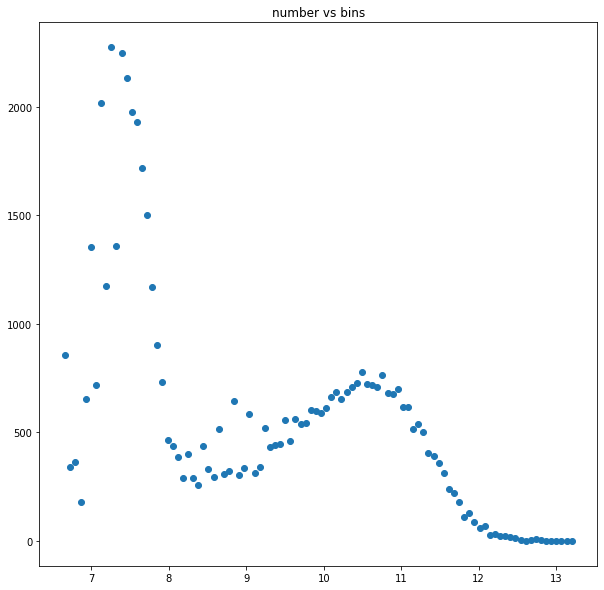

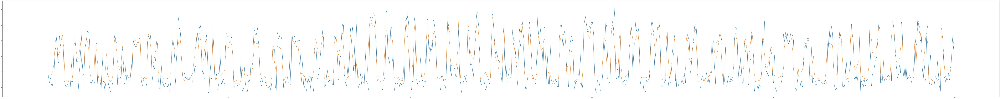

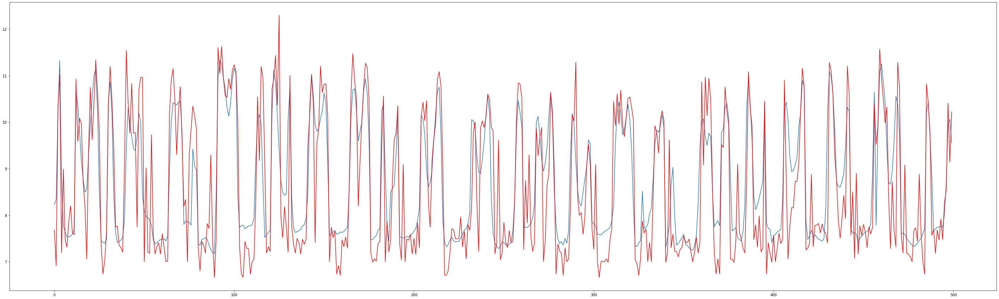

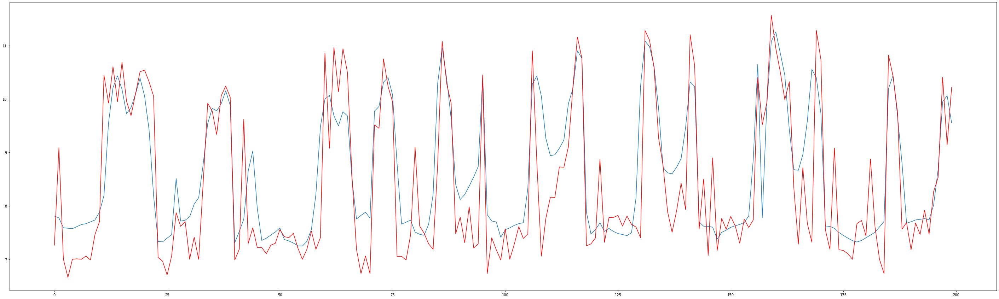

In [50]:
model.save('custom_loss2_13')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

In [51]:

model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), batch_size=8192,epochs=1000)


Train on 1838283 samples, validate on 55210 samples
Epoch 1/1000
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.4228 - mse: 0.4228 - val_loss: 0.6152 - val_mse: 0.6152
Epoch 2/1000
1838283/1838283 [==============================] - 8s 4us/step - loss: 0.4229 - mse: 0.4229 - val_loss: 0.6151 - val_mse: 0.6151
Epoch 3/1000
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.4218 - mse: 0.4218 - val_loss: 0.6215 - val_mse: 0.6215
Epoch 4/1000
1838283/1838283 [==============================] - 8s 4us/step - loss: 0.4215 - mse: 0.4215 - val_loss: 0.6117 - val_mse: 0.6117
Epoch 5/1000
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.4218 - mse: 0.4218 - val_loss: 0.6134 - val_mse: 0.6134
Epoch 6/1000
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.4207 - mse: 0.4207 - val_loss: 0.6217 - val_mse: 0.6217
Epoch 7/1000
1838283/1838283 [==============================] - 7s 4us/step - loss: 0.4214 - mse

Epoch 58/1000
1838283/1838283 [==============================] - 11s 6us/step - loss: 0.4128 - mse: 0.4128 - val_loss: 0.5983 - val_mse: 0.5983
Epoch 59/1000
1838283/1838283 [==============================] - 11s 6us/step - loss: 0.4115 - mse: 0.4115 - val_loss: 0.6061 - val_mse: 0.6061
Epoch 60/1000
1838283/1838283 [==============================] - 11s 6us/step - loss: 0.4111 - mse: 0.4111 - val_loss: 0.6035 - val_mse: 0.6035
Epoch 61/1000
1838283/1838283 [==============================] - 11s 6us/step - loss: 0.4106 - mse: 0.4106 - val_loss: 0.5990 - val_mse: 0.5990
Epoch 62/1000
1838283/1838283 [==============================] - 11s 6us/step - loss: 0.4107 - mse: 0.4107 - val_loss: 0.6004 - val_mse: 0.6004
Epoch 63/1000
1838283/1838283 [==============================] - 11s 6us/step - loss: 0.4108 - mse: 0.4108 - val_loss: 0.5993 - val_mse: 0.5993
Epoch 64/1000
1838283/1838283 [==============================] - 11s 6us/step - loss: 0.4108 - mse: 0.4108 - val_loss: 0.5988 - val_mse:

Epoch 115/1000
1838283/1838283 [==============================] - 12s 7us/step - loss: 0.4058 - mse: 0.4058 - val_loss: 0.5940 - val_mse: 0.5940
Epoch 116/1000
1838283/1838283 [==============================] - 12s 6us/step - loss: 0.4058 - mse: 0.4058 - val_loss: 0.5945 - val_mse: 0.5945
Epoch 117/1000
1838283/1838283 [==============================] - 12s 6us/step - loss: 0.4054 - mse: 0.4054 - val_loss: 0.5957 - val_mse: 0.5957
Epoch 118/1000
1838283/1838283 [==============================] - 12s 6us/step - loss: 0.4056 - mse: 0.4056 - val_loss: 0.5947 - val_mse: 0.5947
Epoch 119/1000
1838283/1838283 [==============================] - 12s 6us/step - loss: 0.4054 - mse: 0.4054 - val_loss: 0.6051 - val_mse: 0.6051
Epoch 120/1000
1838283/1838283 [==============================] - 12s 6us/step - loss: 0.4051 - mse: 0.4051 - val_loss: 0.5948 - val_mse: 0.5948
Epoch 121/1000
1838283/1838283 [==============================] - 12s 6us/step - loss: 0.4132 - mse: 0.4132 - val_loss: 0.5966 - v

1838283/1838283 [==============================] - 12s 6us/step - loss: 0.4018 - mse: 0.4018 - val_loss: 0.5903 - val_mse: 0.5903
Epoch 172/1000
1838283/1838283 [==============================] - 12s 7us/step - loss: 0.4018 - mse: 0.4018 - val_loss: 0.5940 - val_mse: 0.5940
Epoch 173/1000
1838283/1838283 [==============================] - 12s 6us/step - loss: 0.4014 - mse: 0.4014 - val_loss: 0.5921 - val_mse: 0.5921
Epoch 174/1000
1838283/1838283 [==============================] - 12s 7us/step - loss: 0.4015 - mse: 0.4015 - val_loss: 0.5915 - val_mse: 0.5915
Epoch 175/1000
1838283/1838283 [==============================] - 12s 7us/step - loss: 0.4013 - mse: 0.4013 - val_loss: 0.5916 - val_mse: 0.5916
Epoch 176/1000
1838283/1838283 [==============================] - 12s 6us/step - loss: 0.4016 - mse: 0.4016 - val_loss: 0.5938 - val_mse: 0.5938
Epoch 177/1000
1838283/1838283 [==============================] - 12s 7us/step - loss: 0.4008 - mse: 0.4008 - val_loss: 0.5934 - val_mse: 0.5934


1838283/1838283 [==============================] - 12s 7us/step - loss: 0.3985 - mse: 0.3985 - val_loss: 0.5883 - val_mse: 0.5883
Epoch 228/1000
1838283/1838283 [==============================] - 12s 7us/step - loss: 0.3988 - mse: 0.3988 - val_loss: 0.5954 - val_mse: 0.5954
Epoch 229/1000
1838283/1838283 [==============================] - 12s 7us/step - loss: 0.4085 - mse: 0.4085 - val_loss: 0.6008 - val_mse: 0.6008
Epoch 230/1000
1838283/1838283 [==============================] - 12s 6us/step - loss: 0.4471 - mse: 0.4471 - val_loss: 0.6009 - val_mse: 0.6009
Epoch 231/1000
1838283/1838283 [==============================] - 12s 7us/step - loss: 0.4399 - mse: 0.4399 - val_loss: 0.5898 - val_mse: 0.5898
Epoch 232/1000
1838283/1838283 [==============================] - 12s 7us/step - loss: 0.4319 - mse: 0.4319 - val_loss: 0.5933 - val_mse: 0.5933
Epoch 233/1000
1838283/1838283 [==============================] - 12s 7us/step - loss: 0.4286 - mse: 0.4286 - val_loss: 0.5925 - val_mse: 0.5925


1838283/1838283 [==============================] - 13s 7us/step - loss: 0.4158 - mse: 0.4158 - val_loss: 0.5920 - val_mse: 0.5920
Epoch 284/1000
1838283/1838283 [==============================] - 13s 7us/step - loss: 0.4157 - mse: 0.4157 - val_loss: 0.5905 - val_mse: 0.5905
Epoch 285/1000
1838283/1838283 [==============================] - 13s 7us/step - loss: 0.4155 - mse: 0.4155 - val_loss: 0.5898 - val_mse: 0.5898
Epoch 286/1000
1838283/1838283 [==============================] - 13s 7us/step - loss: 0.4148 - mse: 0.4148 - val_loss: 0.5940 - val_mse: 0.5940
Epoch 287/1000
1838283/1838283 [==============================] - 13s 7us/step - loss: 0.4150 - mse: 0.4150 - val_loss: 0.5896 - val_mse: 0.5896
Epoch 288/1000
1838283/1838283 [==============================] - 13s 7us/step - loss: 0.4148 - mse: 0.4148 - val_loss: 0.5883 - val_mse: 0.5883
Epoch 289/1000
1838283/1838283 [==============================] - 13s 7us/step - loss: 0.4146 - mse: 0.4146 - val_loss: 0.5894 - val_mse: 0.5894


1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3953 - mse: 0.3953 - val_loss: 0.5876 - val_mse: 0.5876
Epoch 340/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3952 - mse: 0.3952 - val_loss: 0.5877 - val_mse: 0.5877
Epoch 341/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3949 - mse: 0.3949 - val_loss: 0.5904 - val_mse: 0.5904
Epoch 342/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3952 - mse: 0.3952 - val_loss: 0.5894 - val_mse: 0.5894
Epoch 343/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3949 - mse: 0.3949 - val_loss: 0.5861 - val_mse: 0.5861
Epoch 344/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3946 - mse: 0.3946 - val_loss: 0.5873 - val_mse: 0.5873
Epoch 345/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3949 - mse: 0.3949 - val_loss: 0.5866 - val_mse: 0.5866
Epoch 3

Epoch 396/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3933 - mse: 0.3933 - val_loss: 0.5880 - val_mse: 0.5880
Epoch 397/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3932 - mse: 0.3932 - val_loss: 0.5937 - val_mse: 0.5937
Epoch 398/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3936 - mse: 0.3936 - val_loss: 0.5868 - val_mse: 0.5868
Epoch 399/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3934 - mse: 0.3934 - val_loss: 0.5836 - val_mse: 0.5836
Epoch 400/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3930 - mse: 0.3930 - val_loss: 0.5880 - val_mse: 0.5880
Epoch 401/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3934 - mse: 0.3934 - val_loss: 0.5884 - val_mse: 0.5884
Epoch 402/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3930 - mse: 0.3930 - val_loss: 0.5881 - val_mse:

Epoch 453/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3921 - mse: 0.3921 - val_loss: 0.5855 - val_mse: 0.5855
Epoch 454/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3920 - mse: 0.3920 - val_loss: 0.5863 - val_mse: 0.5863
Epoch 455/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3922 - mse: 0.3922 - val_loss: 0.5886 - val_mse: 0.5886
Epoch 456/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3922 - mse: 0.3922 - val_loss: 0.5867 - val_mse: 0.5867
Epoch 457/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3919 - mse: 0.3919 - val_loss: 0.5867 - val_mse: 0.5867
Epoch 458/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3917 - mse: 0.3917 - val_loss: 0.5897 - val_mse: 0.5897
Epoch 459/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3917 - mse: 0.3917 - val_loss: 0.5891 - val_mse:

Epoch 510/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3922 - mse: 0.3922 - val_loss: 0.5869 - val_mse: 0.5869
Epoch 511/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3925 - mse: 0.3925 - val_loss: 0.5875 - val_mse: 0.5875
Epoch 512/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3919 - mse: 0.3919 - val_loss: 0.5892 - val_mse: 0.5892
Epoch 513/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3913 - mse: 0.3913 - val_loss: 0.5872 - val_mse: 0.5872
Epoch 514/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3914 - mse: 0.3914 - val_loss: 0.5866 - val_mse: 0.5866
Epoch 515/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3923 - mse: 0.3923 - val_loss: 0.5860 - val_mse: 0.5860
Epoch 516/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3918 - mse: 0.3918 - val_loss: 0.5910 - val_mse:

Epoch 567/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3950 - mse: 0.3950 - val_loss: 0.5869 - val_mse: 0.5869
Epoch 568/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3950 - mse: 0.3950 - val_loss: 0.5843 - val_mse: 0.5843
Epoch 569/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3948 - mse: 0.3948 - val_loss: 0.5853 - val_mse: 0.5853
Epoch 570/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3921 - mse: 0.3921 - val_loss: 0.5893 - val_mse: 0.5893
Epoch 571/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3908 - mse: 0.3908 - val_loss: 0.5889 - val_mse: 0.5889
Epoch 572/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3921 - mse: 0.3921 - val_loss: 0.5903 - val_mse: 0.5903
Epoch 573/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3907 - mse: 0.3907 - val_loss: 0.5867 - val_mse:

Epoch 624/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3892 - mse: 0.3892 - val_loss: 0.5846 - val_mse: 0.5846
Epoch 625/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3896 - mse: 0.3896 - val_loss: 0.5846 - val_mse: 0.5846
Epoch 626/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3892 - mse: 0.3892 - val_loss: 0.5887 - val_mse: 0.5887
Epoch 627/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3892 - mse: 0.3892 - val_loss: 0.5856 - val_mse: 0.5856
Epoch 628/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3908 - mse: 0.3908 - val_loss: 0.5875 - val_mse: 0.5875
Epoch 629/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3895 - mse: 0.3895 - val_loss: 0.5847 - val_mse: 0.5847
Epoch 630/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3894 - mse: 0.3894 - val_loss: 0.5858 - val_mse:

Epoch 681/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.4023 - mse: 0.4023 - val_loss: 0.5864 - val_mse: 0.5864
Epoch 682/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.4020 - mse: 0.4020 - val_loss: 0.5863 - val_mse: 0.5863
Epoch 683/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.4026 - mse: 0.4026 - val_loss: 0.5862 - val_mse: 0.5862
Epoch 684/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.4008 - mse: 0.4008 - val_loss: 0.5854 - val_mse: 0.5854
Epoch 685/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.4149 - mse: 0.4149 - val_loss: 0.5853 - val_mse: 0.5853
Epoch 686/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.4007 - mse: 0.4007 - val_loss: 0.5853 - val_mse: 0.5853
Epoch 687/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3985 - mse: 0.3985 - val_loss: 0.5858 - val_mse:

Epoch 738/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3903 - mse: 0.3903 - val_loss: 0.5880 - val_mse: 0.5880
Epoch 739/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3886 - mse: 0.3886 - val_loss: 0.5883 - val_mse: 0.5883
Epoch 740/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3883 - mse: 0.3883 - val_loss: 0.5867 - val_mse: 0.5867
Epoch 741/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3885 - mse: 0.3885 - val_loss: 0.5874 - val_mse: 0.5874
Epoch 742/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3892 - mse: 0.3892 - val_loss: 0.5854 - val_mse: 0.5854
Epoch 743/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3891 - mse: 0.3891 - val_loss: 0.5886 - val_mse: 0.5886
Epoch 744/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3886 - mse: 0.3886 - val_loss: 0.5965 - val_mse:

Epoch 795/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3980 - mse: 0.3980 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 796/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3982 - mse: 0.3982 - val_loss: 0.5881 - val_mse: 0.5881
Epoch 797/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3994 - mse: 0.3994 - val_loss: 0.5857 - val_mse: 0.5857
Epoch 798/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3923 - mse: 0.3923 - val_loss: 0.5892 - val_mse: 0.5892
Epoch 799/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3894 - mse: 0.3894 - val_loss: 0.5882 - val_mse: 0.5882
Epoch 800/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3889 - mse: 0.3889 - val_loss: 0.5903 - val_mse: 0.5903
Epoch 801/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3885 - mse: 0.3885 - val_loss: 0.5885 - val_mse:

Epoch 852/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3972 - mse: 0.3972 - val_loss: 0.5883 - val_mse: 0.5883
Epoch 853/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3969 - mse: 0.3969 - val_loss: 0.5866 - val_mse: 0.5866
Epoch 854/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3964 - mse: 0.3964 - val_loss: 0.5883 - val_mse: 0.5883
Epoch 855/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3963 - mse: 0.3963 - val_loss: 0.5843 - val_mse: 0.5843
Epoch 856/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3960 - mse: 0.3960 - val_loss: 0.5896 - val_mse: 0.5896
Epoch 857/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3959 - mse: 0.3959 - val_loss: 0.5889 - val_mse: 0.5889
Epoch 858/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3959 - mse: 0.3959 - val_loss: 0.5886 - val_mse:

Epoch 909/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3868 - mse: 0.3868 - val_loss: 0.5889 - val_mse: 0.5889
Epoch 910/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3884 - mse: 0.3884 - val_loss: 0.5914 - val_mse: 0.5914
Epoch 911/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3866 - mse: 0.3866 - val_loss: 0.5907 - val_mse: 0.5907
Epoch 912/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3865 - mse: 0.3865 - val_loss: 0.5855 - val_mse: 0.5855
Epoch 913/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3870 - mse: 0.3870 - val_loss: 0.5912 - val_mse: 0.5912
Epoch 914/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3868 - mse: 0.3868 - val_loss: 0.5924 - val_mse: 0.5924
Epoch 915/1000
1838283/1838283 [==============================] - 5s 3us/step - loss: 0.3866 - mse: 0.3866 - val_loss: 0.5856 - val_mse:

Epoch 966/1000
1838283/1838283 [==============================] - 11s 6us/step - loss: 0.3940 - mse: 0.3940 - val_loss: 0.5937 - val_mse: 0.5937
Epoch 967/1000
1838283/1838283 [==============================] - 12s 6us/step - loss: 0.3941 - mse: 0.3941 - val_loss: 0.5854 - val_mse: 0.5854
Epoch 968/1000
1838283/1838283 [==============================] - 12s 6us/step - loss: 0.3939 - mse: 0.3939 - val_loss: 0.5905 - val_mse: 0.5905
Epoch 969/1000
1838283/1838283 [==============================] - 12s 7us/step - loss: 0.3932 - mse: 0.3932 - val_loss: 0.5955 - val_mse: 0.5955
Epoch 970/1000
1838283/1838283 [==============================] - 12s 6us/step - loss: 0.3935 - mse: 0.3935 - val_loss: 0.5871 - val_mse: 0.5871
Epoch 971/1000
1838283/1838283 [==============================] - 12s 6us/step - loss: 0.3933 - mse: 0.3933 - val_loss: 0.5872 - val_mse: 0.5872
Epoch 972/1000
1838283/1838283 [==============================] - 12s 7us/step - loss: 0.3928 - mse: 0.3928 - val_loss: 0.5891 - v

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.7611685 median ytrue 8.318118323312142


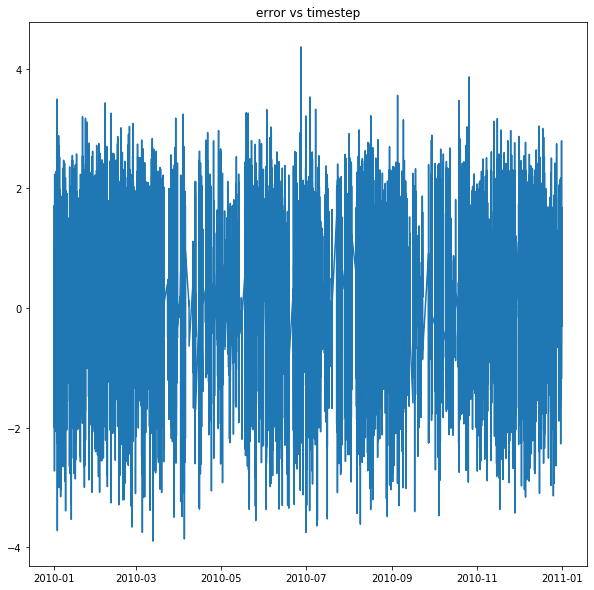

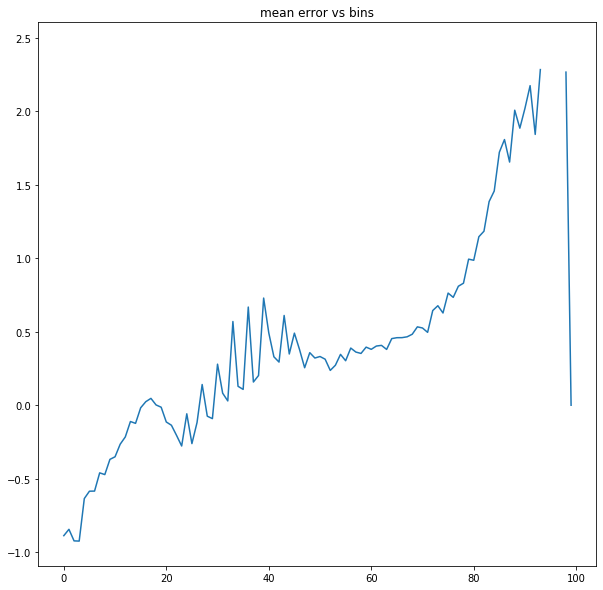

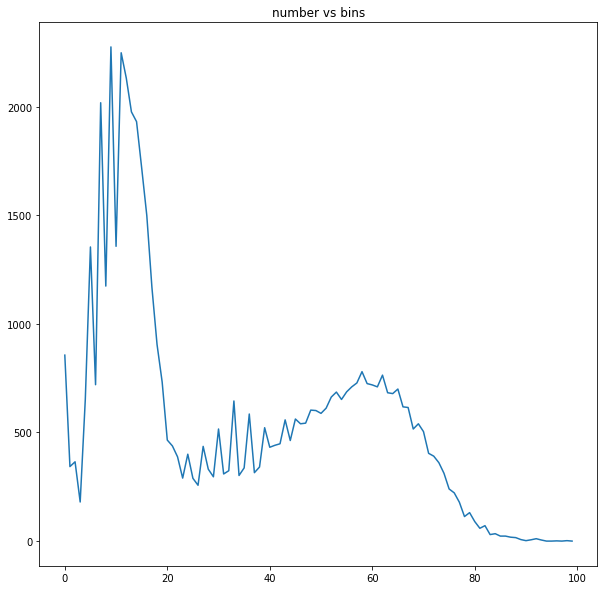

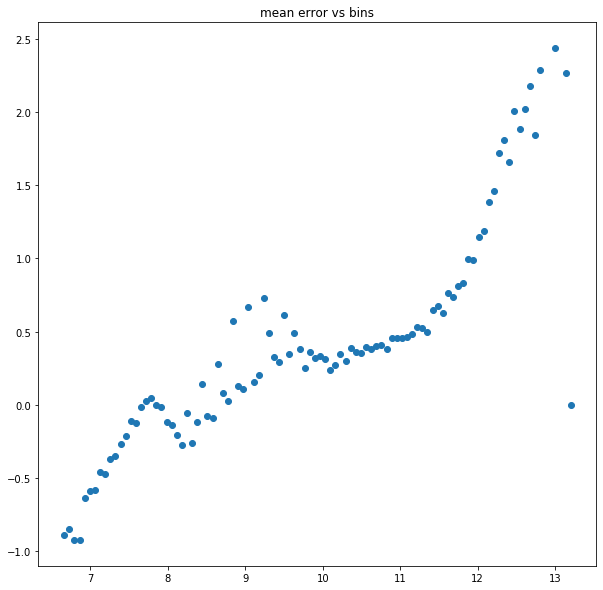

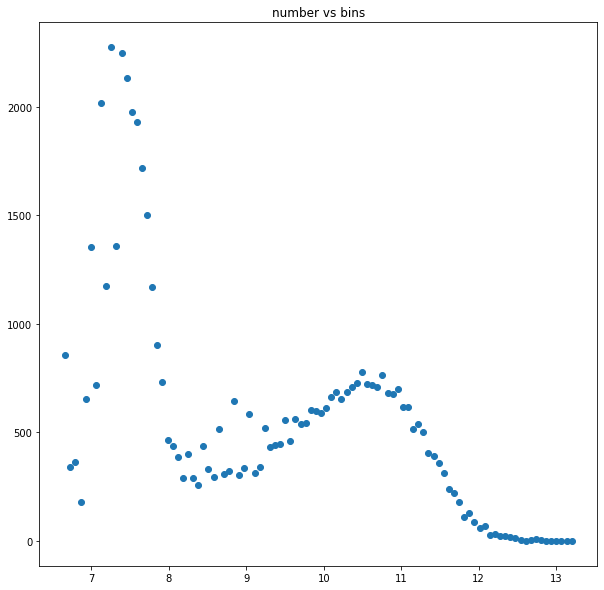

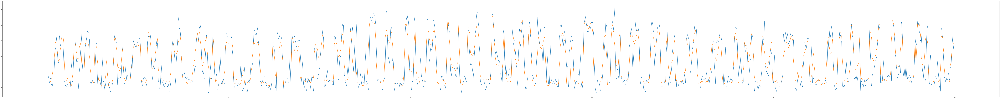

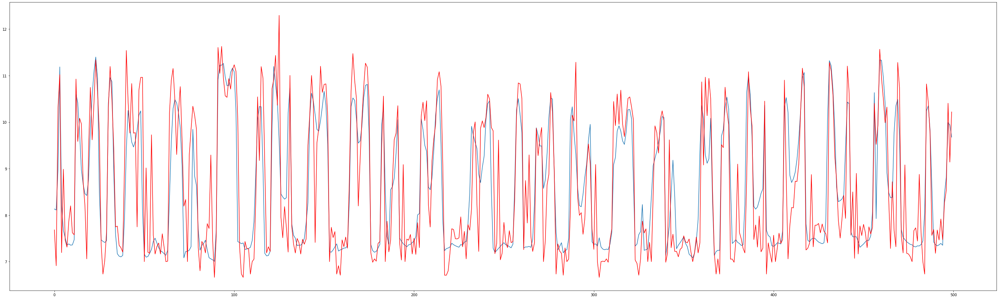

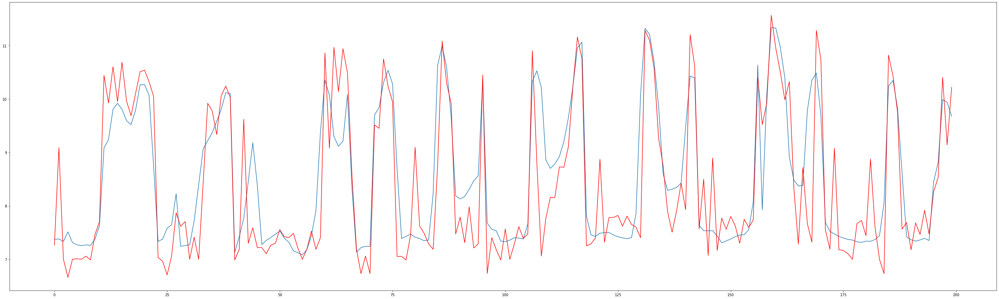

In [52]:
model.save('custom_loss2_14')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()


In [ ]:
model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1, activation='relu'))


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',  metrics=['mse'])

model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), batch_size=8192,epochs=100)

Train on 1838283 samples, validate on 55210 samples
Epoch 1/100
1838283/1838283 [==============================] - 13s 7us/step - loss: 25.2883 - mse: 25.2883 - val_loss: 3.8169 - val_mse: 3.8169
Epoch 2/100
1838283/1838283 [==============================] - 13s 7us/step - loss: 2.8376 - mse: 2.8376 - val_loss: 2.4473 - val_mse: 2.4473
Epoch 3/100
1838283/1838283 [==============================] - 13s 7us/step - loss: 1.5250 - mse: 1.5250 - val_loss: 1.9395 - val_mse: 1.9395
Epoch 4/100
1838283/1838283 [==============================] - 13s 7us/step - loss: 1.3550 - mse: 1.3550 - val_loss: 1.8408 - val_mse: 1.8408
Epoch 5/100
1838283/1838283 [==============================] - 13s 7us/step - loss: 1.2210 - mse: 1.2210 - val_loss: 1.7141 - val_mse: 1.7141
Epoch 6/100
1838283/1838283 [==============================] - 13s 7us/step - loss: 1.1205 - mse: 1.1205 - val_loss: 1.5248 - val_mse: 1.5248
Epoch 7/100
1838283/1838283 [==============================] - 13s 7us/step - loss: 0.9729 - m

In [ ]:
model.save('custom_loss2_15')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()
